<a href="https://colab.research.google.com/github/donbcolab/AIE3/blob/main/brain_tumor_hf_ds_alt_golden.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Brain Tumor Image Dataset - Hugging Face Dataset Creation

This notebook processes a brain tumor image dataset with COCO-format annotations and creates a Hugging Face Dataset.

Key learnings and decisions while creating this brain tumor image dataset for Hugging Face.

1. Data Structure:
   - The dataset contains brain tumor images with COCO-format annotations.
   - Annotations include bounding boxes and polygon segmentations.
   - Categories are structured as: ID 0 (Tumor), ID 1 (0), ID 2 (1), with 1 and 2 being subcategories of Tumor.

2. Segmentation Characteristics:
   - Segmentations are not rectangular but complex polygons.
   - 100% of segmentations are near their bounding boxes.
   - 100% of sampled annotations have valid polygon segmentations.

3. Key Adjustments:
   - We adjusted the 'features' definition to accommodate complex polygon segmentations.
   - The ClassLabel for 'category_id' was updated to ['Tumor', '0', '1'] to match the actual data structure.

4. Data Loading Considerations:
   - Image data is stored as bytes after being read with OpenCV.
   - Segmentation data needs to be carefully handled to maintain its list-of-lists structure.

5. Verification Steps:
   - We implemented functions to verify polygon validity and dataset structure.
   - These checks are crucial before pushing the dataset to the Hugging Face Hub.

6. Performance and Efficiency:
   - We used tqdm for progress tracking during image loading, which is helpful for large datasets.
   - The dataset creation process involves reading and encoding many images, which can be time-consuming.

7. Hugging Face Dataset Structure:
   - The dataset is created using the Hugging Face Datasets library, which has specific requirements for data types and structures.
   - We needed to ensure that all data types in the pandas DataFrame matched the defined features.

8. Potential Future Work:
   - The current implementation doesn't push to the Hugging Face Hub automatically. This step should be done manually after thorough verification.
   - Depending on the specific use case, additional preprocessing or data augmentation steps might be necessary.

## 1. Setup and Imports

This section imports necessary libraries and sets up the environment.


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install -qU pyarrow==14.0.1 requests==2.31.0

In [3]:
!pip install -qU datasets==2.11.0

In [4]:
import os
import json
import pandas as pd
from datasets import Dataset, Features, ClassLabel, Value, Sequence, Image
from tqdm.auto import tqdm
import cv2

## 2. Constants and Configuration
Define constants and configurations used throughout the notebook.


In [5]:
HF_DATASET_NAME = 'brain-tumor-image-dataset-semantic-segmentation-alt'
SOURCE_JSON = "/content/drive/MyDrive/kaggle/datasets/brain-tumor-image-dataset-semantic-segmentation/train/_annotations.coco.json"
SOURCE_IMAGE_DIR = "/content/drive/MyDrive/kaggle/datasets/brain-tumor-image-dataset-semantic-segmentation/train"


## 3. Feature Definition
Define the structure of the Hugging Face Dataset.

In [6]:
features = Features({
    'file_name': Value(dtype='string'),
    'image': Value(dtype='string'),  # This will store the path as "images/filename.jpg"
    'id': Value(dtype='int64'),
    'category_id': ClassLabel(names=['Tumor', '0', '1']),  # Correct class labels
    'bbox': Sequence(feature=Value(dtype='float32'), length=4),
    'segmentation': Sequence(Sequence(Value(dtype='float32'))),
    'area': Value(dtype='float32'),
    'iscrowd': Value(dtype='int64'),
    'height': Value(dtype='int64'),
    'width': Value(dtype='int64'),
    'date_captured': Value(dtype='string'),
    'license': Value(dtype='int64')
})

## 4. Data Loading and Preprocessing
Functions to load and preprocess the COCO-format data.

In [7]:
def verify_source_data():
    with open(SOURCE_JSON, 'r') as f:
        data = json.load(f)

    print("Categories:")
    for category in data['categories']:
        print(f"ID: {category['id']}, Name: {category['name']}, Supercategory: {category['supercategory']}")

    category_counts = pd.DataFrame(data['annotations'])['category_id'].value_counts().sort_index()
    print("\nCategory distribution in annotations:")
    print(category_counts)

    # Check for images with multiple bounding boxes
    image_bbox_counts = pd.DataFrame(data['annotations'])['image_id'].value_counts()
    print(f"\nImages with multiple bounding boxes: {(image_bbox_counts > 1).sum()}")
    print(f"Max bounding boxes in an image: {image_bbox_counts.max()}")

In [8]:
def load_data_to_df():
    with open(SOURCE_JSON, 'r') as f:
        data = json.load(f)

    images = pd.DataFrame(data['images'])
    annotations = pd.DataFrame(data['annotations'])

    df = pd.merge(images, annotations, left_on='id', right_on='image_id', suffixes=('', '_ann'))
    df = df.drop(columns=['id_ann', 'image_id'])

    # Store relative paths
    # prepend "images/"
    # Set the correct image path for the dataset viewer
    df['image'] = df['file_name'].apply(lambda x: f"images/{x}")


    # Inspect category_id values
    print("Unique category_id values:", df['category_id'].unique())
    print("Category_id value counts:\n", df['category_id'].value_counts())

    return df

In [9]:
import shutil
import os

# Function to prepare dataset for upload
def prepare_dataset_for_upload(dataset, hf_dataset_name):
    # Create dataset directory
    os.makedirs(hf_dataset_name, exist_ok=True)
    images_dir = os.path.join(hf_dataset_name, "images")
    os.makedirs(images_dir, exist_ok=True)

    # Copy image files and update paths
    def process_example(example):
        src_path = os.path.join(SOURCE_IMAGE_DIR, example['file_name'])
        dst_path = os.path.join(images_dir, example['file_name'])
        shutil.copy2(src_path, dst_path)
        example['image'] = os.path.join("images", example['file_name'])
        return example

    updated_dataset = dataset.map(process_example)

    # Save the updated dataset
    updated_dataset.save_to_disk(hf_dataset_name)

    print(f"Dataset prepared for upload in directory: {hf_dataset_name}")
    return updated_dataset

## 5. Dataset Creation
Function to create the Hugging Face Dataset from the preprocessed data.

In [10]:
from PIL import Image as PILImage

def create_hf_dataset(df, hf_dataset_name):
    """Creates a Hugging Face Dataset from preprocessed data."""
    # Ensure datatypes match the features
    df['bbox'] = df['bbox'].apply(lambda x: [float(i) for i in x])
    df['segmentation'] = df['segmentation'].apply(lambda x: [[float(i) for i in poly] for poly in x])
    df['area'] = df['area'].astype('float32')

    # Create the dataset
    dataset = Dataset.from_pandas(df, features=features)
    print(f"Dataset created successfully with {len(dataset)} examples.")
    return dataset

## 6. Verification Functions
Functions to verify the integrity and structure of the data and created dataset.

In [11]:
import json
from collections import Counter

with open(SOURCE_JSON, 'r') as f:
    coco_data = json.load(f)

category_ids = [ann['category_id'] for ann in coco_data['annotations']]
id_counts = Counter(category_ids)

categories = {cat['id']: cat['name'] for cat in coco_data['categories']}

print("Category ID counts:", id_counts)
print("Category mappings:", categories)

# Automated verification
expected_categories = {0: 'Tumor', 1: '0', 2: '1'}
assert categories == expected_categories, f"Category mismatch. Expected {expected_categories}, got {categories}"
assert set(id_counts.keys()) == {1, 2}, f"Unexpected category IDs found: {set(id_counts.keys())}"

Category ID counts: Counter({1: 771, 2: 731})
Category mappings: {0: 'Tumor', 1: '0', 2: '1'}


In [12]:
def is_valid_polygon(segmentation):
    # Check if it's a list of lists
    if not isinstance(segmentation, list) or not all(isinstance(poly, list) for poly in segmentation):
        return False

    # Check if each polygon has at least 6 coordinates (3 points)
    if not all(len(poly) >= 6 and len(poly) % 2 == 0 for poly in segmentation):
        return False

    return True

sample_annotations = coco_data['annotations'][:100]
valid_count = sum(is_valid_polygon(ann['segmentation']) for ann in sample_annotations)
valid_percentage = (valid_count / len(sample_annotations)) * 100
print(f"{valid_percentage:.2f}% of sampled annotations have valid polygon segmentations")

100.00% of sampled annotations have valid polygon segmentations


In [13]:
def verify_dataset(dataset):
    print(f"Dataset contains {len(dataset)} examples.")
    print("Sample of the first example:")
    print(dataset[0])

    # Check if all required fields are present
    required_fields = ['file_name', 'image', 'id', 'category_id', 'bbox', 'segmentation', 'area']
    for field in required_fields:
        if field not in dataset[0]:
            print(f"Warning: '{field}' is missing from the dataset.")

    # Verify image data
    if isinstance(dataset[0]['image'], str):
        print("Image data is stored as file paths.")
    else:
        print("Warning: Image data is not stored as file paths.")

    # Verify segmentation data
    if isinstance(dataset[0]['segmentation'], list) and isinstance(dataset[0]['segmentation'][0], list):
        print("Segmentation data is stored as a list of lists.")
    else:
        print("Warning: Segmentation data is not stored as a list of lists.")

    print("Dataset verification complete.")

In [14]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def visualize_samples(dataset, num_samples=5):
    """Visualize a few sample images with annotations."""
    for i in range(num_samples):
        example = dataset[i]

        # Load image
        img = Image.open(os.path.join(SOURCE_IMAGE_DIR, example['file_name']))
        plt.figure(figsize=(10, 10))
        plt.imshow(img)

        # Draw bounding box
        bbox = example['bbox']
        rect = plt.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                             fill=False, edgecolor='red', linewidth=2)
        plt.gca().add_patch(rect)

        # Draw segmentation
        seg = np.array(example['segmentation']).reshape(-1, 2)
        plt.plot(seg[:, 0], seg[:, 1], color='blue', linewidth=2)

        plt.title(f"Category: {example['category_id']}")
        plt.axis('off')
        plt.show()

## 7. Main Execution
The main workflow to create and verify the dataset.

Unique category_id values: [1 2]
Category_id value counts:
 category_id
1    771
2    731
Name: count, dtype: int64
Dataset created successfully with 1502 examples.
Dataset contains 1502 examples.
Sample of the first example:
{'file_name': '2256_jpg.rf.3afd7903eaf3f3c5aa8da4bbb928bc19.jpg', 'image': 'images/2256_jpg.rf.3afd7903eaf3f3c5aa8da4bbb928bc19.jpg', 'id': 0, 'category_id': 1, 'bbox': [145.0, 239.0, 168.75, 162.5], 'segmentation': [[313.75, 238.75, 145.0, 238.75, 145.0, 401.25, 313.75, 401.25, 313.75, 238.75]], 'area': 27421.875, 'iscrowd': 0, 'height': 640, 'width': 640, 'date_captured': '2023-08-19T04:37:54+00:00', 'license': 1}
Image data is stored as file paths.
Segmentation data is stored as a list of lists.
Dataset verification complete.


Map:   0%|          | 0/1502 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/1502 [00:00<?, ? examples/s]

Dataset prepared for upload in directory: brain-tumor-image-dataset-semantic-segmentation-alt


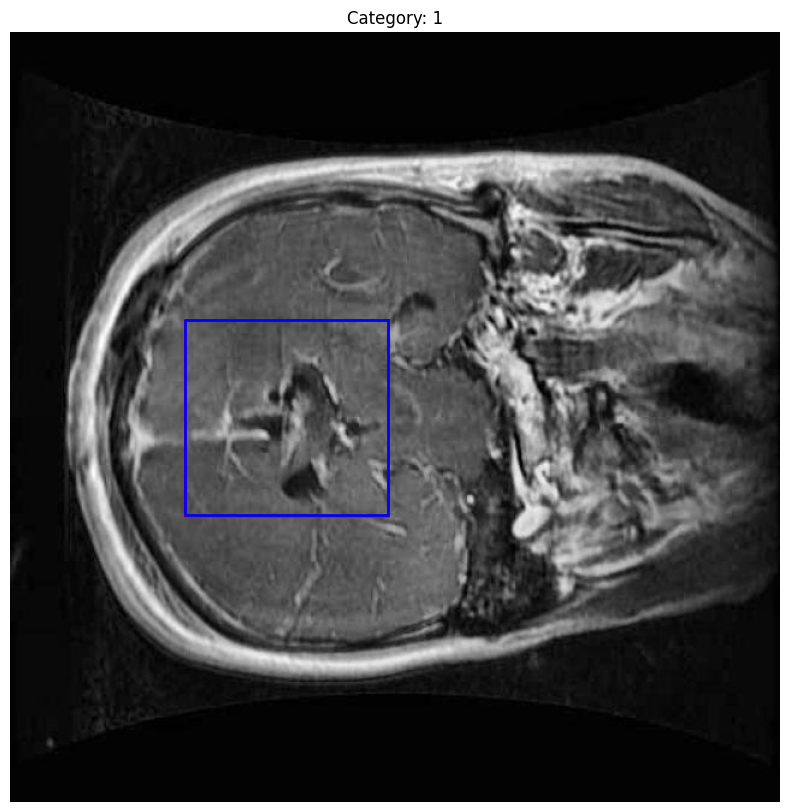

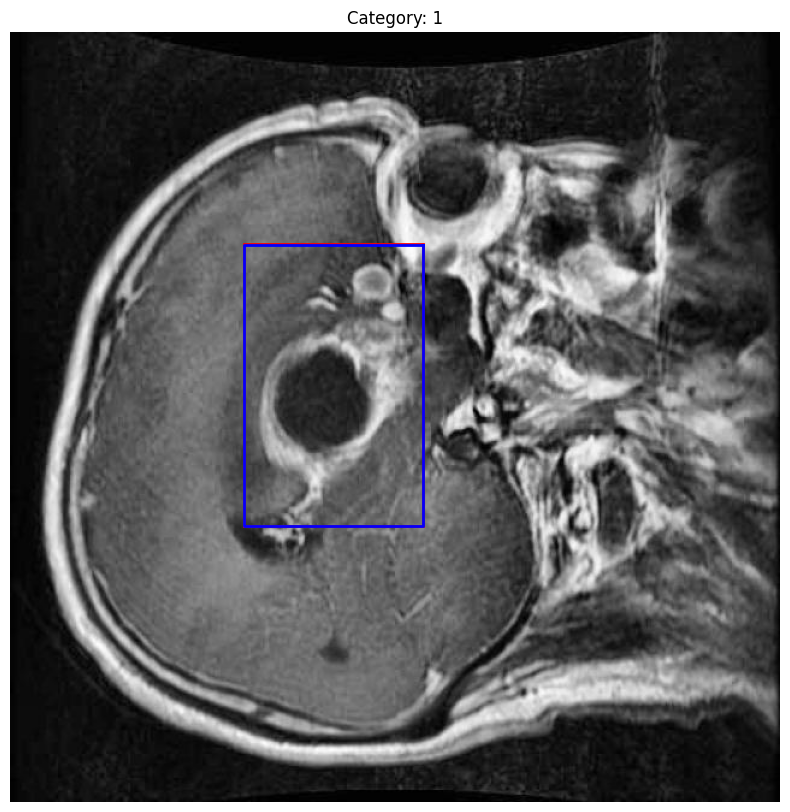

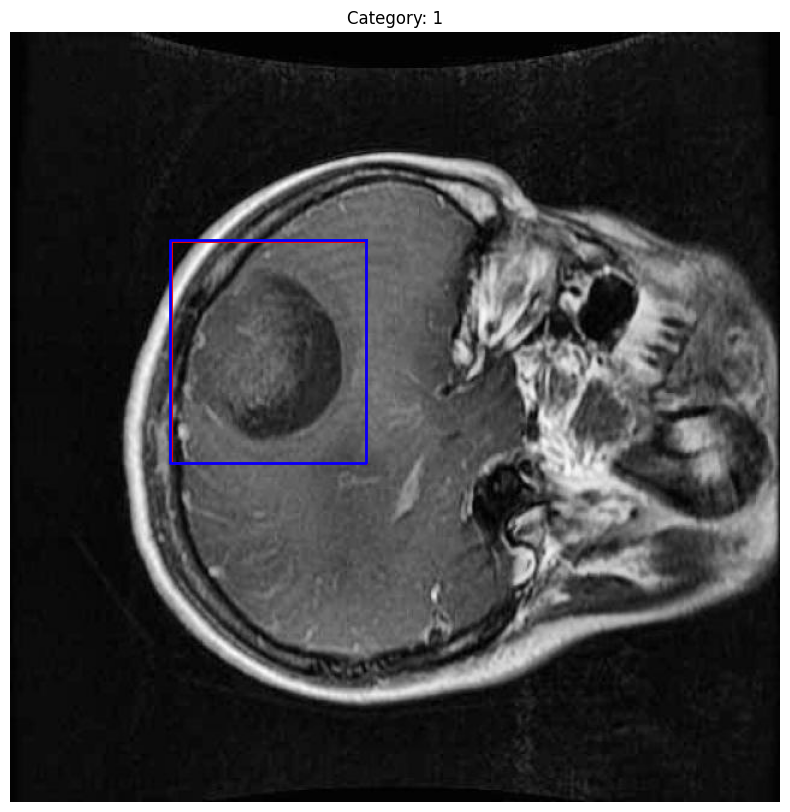

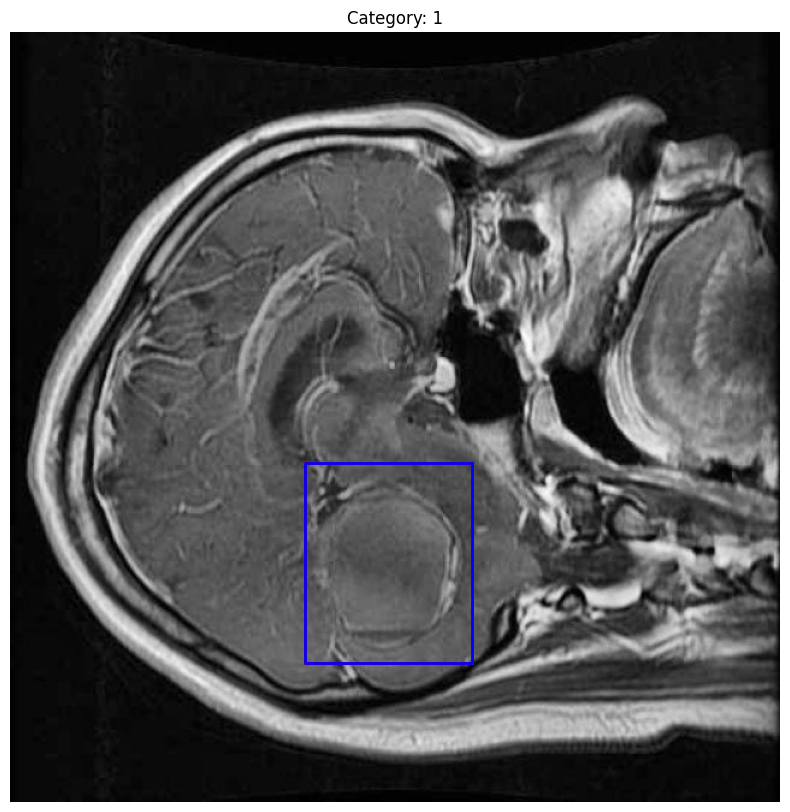

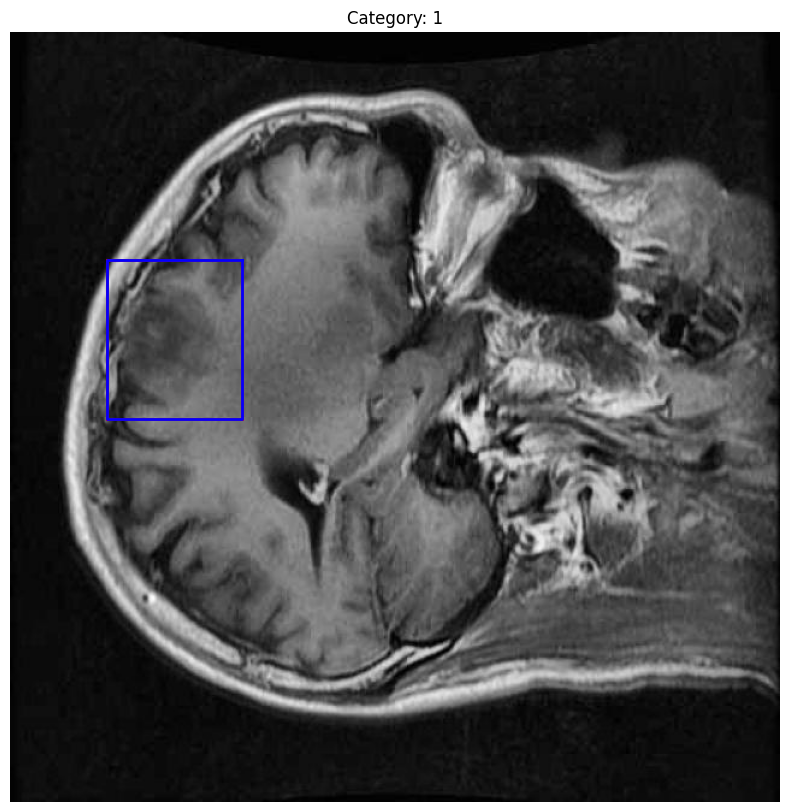

Saving the dataset (0/1 shards):   0%|          | 0/1502 [00:00<?, ? examples/s]

Dataset saved to brain-tumor-image-dataset-semantic-segmentation-alt


In [15]:
# Load and prepare the data
df = load_data_to_df()

# Create the dataset
dataset = create_hf_dataset(df, HF_DATASET_NAME)

# Verify the dataset
verify_dataset(dataset)

# Prepare the dataset for upload
prepared_dataset = prepare_dataset_for_upload(dataset, HF_DATASET_NAME)

# Visualize samples from the prepared dataset
visualize_samples(prepared_dataset)

# Save the prepared dataset
prepared_dataset.save_to_disk(HF_DATASET_NAME)

print(f"Dataset saved to {HF_DATASET_NAME}")

In [16]:
display(df)

,id,license,file_name,height,width,date_captured,category_id,bbox,area,segmentation,iscrowd,image
0,0,1,2256_jpg.rf.3afd7903eaf3f3c5aa8da4bbb928bc19.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[145.0, 239.0, 168.75, 162.5]",27421.8750,"[[313.75, 238.75, 145.0, 238.75, 145.0, 401.25...",0,images/2256_jpg.rf.3afd7903eaf3f3c5aa8da4bbb92...
1,1,1,2871_jpg.rf.3b6eadfbb369abc2b3bcb52b406b74f2.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[194.0, 176.0, 148.75, 233.75]",34770.3125,"[[342.5, 176.25, 193.75, 176.25, 193.75, 410.0...",0,images/2871_jpg.rf.3b6eadfbb369abc2b3bcb52b406...
2,2,1,2921_jpg.rf.3b952f91f27a6248091e7601c22323ad.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[133.0, 173.0, 162.5, 185.0]",30062.5000,"[[295.0, 172.5, 132.5, 172.5, 132.5, 357.5, 29...",0,images/2921_jpg.rf.3b952f91f27a6248091e7601c22...
3,3,1,2777_jpg.rf.3b60ea7f7e70552e70e41528052018bd.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[245.0, 358.0, 138.75, 166.25]",23067.1875,"[[383.75, 357.5, 245.0, 357.5, 245.0, 523.75, ...",0,images/2777_jpg.rf.3b60ea7f7e70552e70e41528052...
4,4,1,2860_jpg.rf.3bb87fa4f938af5abfb1e17676ec1dad.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[80.0, 189.0, 112.5, 132.5]",14906.2500,"[[192.5, 188.75, 80.0, 188.75, 80.0, 321.25, 1...",0,images/2860_jpg.rf.3bb87fa4f938af5abfb1e17676e...
...,...,...,...,...,...,...,...,...,...,...,...,...
1497,1497,1,1365_jpg.rf.fe6ceef68f802f62e68bfe86cbedf4c0.jpg,640,640,2023-08-19T04:37:54+00:00,2,"[194.0, 264.0, 106.25, 122.5]",13015.6250,"[[300.0, 263.75, 193.75, 263.75, 193.75, 386.2...",0,images/1365_jpg.rf.fe6ceef68f802f62e68bfe86cbe...
1498,1498,1,2242_jpg.rf.ffaeadc4d4d6b67d5829ab30c8919708.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[145.0, 305.0, 146.25, 145.0]",21206.2500,"[[291.25, 305.0, 145.0, 305.0, 145.0, 450.0, 2...",0,images/2242_jpg.rf.ffaeadc4d4d6b67d5829ab30c89...
1499,1499,1,2636_jpg.rf.ff6b7cbc4a4de3f93d813f6a7c04b4a8.jpg,640,640,2023-08-19T04:37:54+00:00,1,"[274.0, 133.0, 163.75, 173.75]",28451.5625,"[[437.5, 132.5, 273.75, 132.5, 273.75, 306.25,...",0,images/2636_jpg.rf.ff6b7cbc4a4de3f93d813f6a7c0...
1500,1500,1,147_jpg.rf.ff993da0adbed8883db143202e8c0e6e.jpg,640,640,2023-08-19T04:37:54+00:00,2,"[164.0, 311.0, 221.25, 213.75]",47292.1875,"[[385.0, 311.25, 163.75, 311.25, 163.75, 525.0...",0,images/147_jpg.rf.ff993da0adbed8883db143202e8c...


## 8. (Optional) Upload to Hugging Face Hub
Uncomment this section when ready to upload the dataset to the Hugging Face Hub.

In [17]:
# Upload to Hugging Face Hub
# Uncomment these lines when you're ready to upload
from huggingface_hub import HfApi
api = HfApi()
api.upload_folder(
    folder_path=HF_DATASET_NAME,
    repo_id=f"dwb2023/{HF_DATASET_NAME}",
    repo_type="dataset"
)
print(f"Dataset uploaded to https://huggingface.co/datasets/dwb2023/{HF_DATASET_NAME}")

data-00000-of-00001.arrow:   0%|          | 0.00/388k [00:00<?, ?B/s]

1002_jpg.rf.57d3a8702704771f3315b19aac1aaae7.jpg:   0%|          | 0.00/50.3k [00:00<?, ?B/s]

1004_jpg.rf.373053c1dd48b8a6bc7ac7f93d4702ac.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

1000_jpg.rf.1c16148495900a466a53f121ec6af0a9.jpg:   0%|          | 0.00/45.8k [00:00<?, ?B/s]

1003_jpg.rf.9caed0c16ef6b6a9cc174256657810c1.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

Upload 1502 LFS files:   0%|          | 0/1502 [00:00<?, ?it/s]

1005_jpg.rf.26a35018e228afa0f075d4a09fd8769b.jpg:   0%|          | 0.00/36.9k [00:00<?, ?B/s]

1008_jpg.rf.492d7251d486bdcdc078e388dad8d205.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

100_jpg.rf.277787736bda26448d531e9285a5b086.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

1010_jpg.rf.82ea169b57b773929009fa13b7aa704b.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

1012_jpg.rf.453866333dd04def7d83896e33f77155.jpg:   0%|          | 0.00/44.6k [00:00<?, ?B/s]

1013_jpg.rf.05704b16d3d0f4dd9803edc53b723520.jpg:   0%|          | 0.00/50.7k [00:00<?, ?B/s]

1014_jpg.rf.e4d01976894e0d082ed45905b50c1243.jpg:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

1015_jpg.rf.4f61b1e8e47b49b874b6280e7a630aa4.jpg:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1016_jpg.rf.1e728d7539e99ed821f48d5047e6307f.jpg:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1019_jpg.rf.9393e0f9e2ee3f85d07f486d4933d090.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

1020_jpg.rf.ab4559fd5bc096251a1c17e1cec8721c.jpg:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

1025_jpg.rf.8bf4d04963095fe03d3d5a0d0db75fc6.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1026_jpg.rf.d12e816a89aee042b5bb604deeaade74.jpg:   0%|          | 0.00/53.9k [00:00<?, ?B/s]

1027_jpg.rf.a3dbd9c542cf8dbbf02e0f669ee00e98.jpg:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

1028_jpg.rf.9b892320a9c3bdf87b695852f93c3c44.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1029_jpg.rf.554be04f7e39890bc41d252f6e8a859d.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

102_jpg.rf.e83b6770ae0daf212ac56cda9ff4518e.jpg:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

1031_jpg.rf.44112dc6705a82ac209f36e6755ecc58.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

1032_jpg.rf.ea3be0473c47174eb65897646fb4ab25.jpg:   0%|          | 0.00/49.0k [00:00<?, ?B/s]

1034_jpg.rf.332243c520ad5556581686595011a3f4.jpg:   0%|          | 0.00/55.5k [00:00<?, ?B/s]

1037_jpg.rf.ee71d2f5dbee7bd8a255de96528339ee.jpg:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1038_jpg.rf.462754f72017ae18e2c3390b4020a132.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

1039_jpg.rf.8f088391146ef60db8adc7db22fdbbe6.jpg:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

103_jpg.rf.545b7cac5ee5582ca96be24af6e900fe.jpg:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1040_jpg.rf.b2bfe431d0679644b669aabad81e0d8d.jpg:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

1042_jpg.rf.85be139ed883f9011f648f105e9c298a.jpg:   0%|          | 0.00/57.1k [00:00<?, ?B/s]

1043_jpg.rf.21f0c0c9d68fa03d8e2b404ead1e90a7.jpg:   0%|          | 0.00/52.8k [00:00<?, ?B/s]

1044_jpg.rf.dd22d06a56561768d8b18e1201e8c2e7.jpg:   0%|          | 0.00/58.6k [00:00<?, ?B/s]

1046_jpg.rf.f00d24546cfc9932255113d4fcedd4a5.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1047_jpg.rf.1a506954262c89e9ca02543f77021fb3.jpg:   0%|          | 0.00/50.5k [00:00<?, ?B/s]

1049_jpg.rf.25b13d0d637cb68530fdb6737a2ceac3.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

104_jpg.rf.d149386645d8976949dfef7b4b8fc425.jpg:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

1050_jpg.rf.1cb3e5e621712f18f7669082cdc37794.jpg:   0%|          | 0.00/51.3k [00:00<?, ?B/s]

1053_jpg.rf.57389670cb625358e3a08142588776ff.jpg:   0%|          | 0.00/52.8k [00:00<?, ?B/s]

1054_jpg.rf.13cdb804ee7edb71f3a7e3b93d3b174e.jpg:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

1055_jpg.rf.1c6ea51c3a42a39620f10e2e8577b8bb.jpg:   0%|          | 0.00/53.4k [00:00<?, ?B/s]

1059_jpg.rf.08316825e6adde658cb0dfa0970caca4.jpg:   0%|          | 0.00/55.5k [00:00<?, ?B/s]

105_jpg.rf.8cfad6d0c2ddbcc70a3565d7d086aec5.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

1060_jpg.rf.d12b237ae08732bb65ba4e3d84a87f0d.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1062_jpg.rf.b708cc3fb824e426202f0da0064755b0.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

1063_jpg.rf.a0f0f9f2891be8a89a1c3ecef416805e.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1067_jpg.rf.fb8eda76942c725854a2bafa0a23ded8.jpg:   0%|          | 0.00/53.7k [00:00<?, ?B/s]

1068_jpg.rf.a0fdd16c1377807c0d262d6f4740858c.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1069_jpg.rf.7018fcb829d43a52ee66962ab98d07d0.jpg:   0%|          | 0.00/51.0k [00:00<?, ?B/s]

106_jpg.rf.d44c399f287caf026bdd7dc266f18737.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

1073_jpg.rf.f2c45093a171316a5e4753c5deea1c3b.jpg:   0%|          | 0.00/70.1k [00:00<?, ?B/s]

1074_jpg.rf.0e74124a8ed1d798b023a19deab80735.jpg:   0%|          | 0.00/66.2k [00:00<?, ?B/s]

1076_jpg.rf.fb634cad7807debd532ce9d0021d0393.jpg:   0%|          | 0.00/67.6k [00:00<?, ?B/s]

1077_jpg.rf.fc5700577bc090c8aa70df7a29bfe375.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

1078_jpg.rf.f81e310144a97261b8eb1334930c04ef.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1079_jpg.rf.c4cf44265472e6289ee765cab34a834b.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

1080_jpg.rf.9733111d9c29d6b41ded674dcd7a009e.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

1081_jpg.rf.160f394379141bd11e0ad5a2e88a0c44.jpg:   0%|          | 0.00/53.0k [00:00<?, ?B/s]

1084_jpg.rf.c86a8e86898d5c9a027b1039ffae819e.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1085_jpg.rf.186242407de191556c53c3d9648552d0.jpg:   0%|          | 0.00/56.8k [00:00<?, ?B/s]

1086_jpg.rf.e17f206b1ba047fc0d91df7d2fa64598.jpg:   0%|          | 0.00/58.0k [00:00<?, ?B/s]

1087_jpg.rf.1e53dcfee0f265fb956cc8282bcfffcf.jpg:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

1088_jpg.rf.7ca45867e7a4c2800eb62fd70be5c029.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

108_jpg.rf.73ff0828ef05601769946aa8c88a3e9a.jpg:   0%|          | 0.00/29.4k [00:00<?, ?B/s]

1091_jpg.rf.fc8db18ebed3e5c8fb57e4f56e8b8902.jpg:   0%|          | 0.00/57.8k [00:00<?, ?B/s]

1090_jpg.rf.d44b13e3779cc8a57dfbd060b1ce0eb6.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1092_jpg.rf.8839e04a369d73ce355f53d80ad27b3e.jpg:   0%|          | 0.00/56.2k [00:00<?, ?B/s]

1094_jpg.rf.50938707a95802ae328c7dd7d524e558.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1095_jpg.rf.5824eb6693ed01a4e135bf513891768c.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1098_jpg.rf.361bb8511c687d7db21b6539811d5afa.jpg:   0%|          | 0.00/58.3k [00:00<?, ?B/s]

1096_jpg.rf.e79d9ce4e0cba12ff412b1942c5de165.jpg:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1099_jpg.rf.d413ffddfa1457d54b58a228c774db86.jpg:   0%|          | 0.00/58.0k [00:00<?, ?B/s]

109_jpg.rf.c73f8b2917011e432904a4c21c18c84c.jpg:   0%|          | 0.00/28.6k [00:00<?, ?B/s]

10_jpg.rf.68504d449dd333632ea80d4a945b0a77.jpg:   0%|          | 0.00/27.2k [00:00<?, ?B/s]

1100_jpg.rf.7b51f20fa3962515309e14c8928423b9.jpg:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1101_jpg.rf.0b85045dd2e6c2a4ba33e995688c1e66.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1102_jpg.rf.b388f886717c4ca4d0c8a455e0385904.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1105_jpg.rf.408172ab3763b197fa72181bc2b17b93.jpg:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

1104_jpg.rf.7f2fb7aa9439f66ba7dfd952e019f2bc.jpg:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1106_jpg.rf.525623819378618721f6c0df9d787033.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1107_jpg.rf.02dea42aa6cc3e3c7b02f1f41cd7a2f0.jpg:   0%|          | 0.00/58.6k [00:00<?, ?B/s]

1108_jpg.rf.a63a6e2814800065d4a03739a1c7b3ad.jpg:   0%|          | 0.00/57.0k [00:00<?, ?B/s]

1109_jpg.rf.b0d2ae723bfba1cc7a68afb7f5075db0.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1111_jpg.rf.f2d913f65b5ac21fd31aa95fd54369e1.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

110_jpg.rf.ae29280fac449476dadaacdbdca6181f.jpg:   0%|          | 0.00/29.5k [00:00<?, ?B/s]

1112_jpg.rf.6ec10fc2ad0980c34d7b6dcf7103c7bf.jpg:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1113_jpg.rf.72ec8e0580eb21153ef379a281daf160.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1114_jpg.rf.6e54a61ea0c3004532ed55d699221517.jpg:   0%|          | 0.00/54.4k [00:00<?, ?B/s]

1116_jpg.rf.5992a913eef0c747ef96ca7cab421c83.jpg:   0%|          | 0.00/53.0k [00:00<?, ?B/s]

1117_jpg.rf.56cb380f53194649275ad38cbed5321b.jpg:   0%|          | 0.00/49.9k [00:00<?, ?B/s]

1118_jpg.rf.ca2c4697da092c77a4a727d2611f1089.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

111_jpg.rf.7811c27ad1b38376df665ddbcd6bba66.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

1120_jpg.rf.b1a63e6465c86cc79837a323abd36c18.jpg:   0%|          | 0.00/53.1k [00:00<?, ?B/s]

1121_jpg.rf.bfbdb064a9966cd421a4ed03a0a3d149.jpg:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

1123_jpg.rf.1c051b162edf7f0469955fdcd5ee0b55.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1124_jpg.rf.befefac2786da78205dae3c2ae25246f.jpg:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

1127_jpg.rf.d108fa3015f9faab55e259816c6e6a51.jpg:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1128_jpg.rf.657bd16eb21522908d2b2bafc7a3757d.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

1129_jpg.rf.6e144e08b4d0c373b65899437dbd9aba.jpg:   0%|          | 0.00/45.7k [00:00<?, ?B/s]

112_jpg.rf.0989639f00572f41dd3334fdd5240638.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

1131_jpg.rf.c68f4e6b402262b75764e1a47ecdb2c0.jpg:   0%|          | 0.00/47.2k [00:00<?, ?B/s]

1132_jpg.rf.7b8d94cbe88bbaa011d02c242d694b23.jpg:   0%|          | 0.00/46.1k [00:00<?, ?B/s]

1133_jpg.rf.92a3b5e5d9e8bc32da32077e3598913b.jpg:   0%|          | 0.00/45.8k [00:00<?, ?B/s]

1134_jpg.rf.7c2fedcf32284576c52cd249287d636c.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

1135_jpg.rf.c71d7af5905bf8f4e969203ddce120f2.jpg:   0%|          | 0.00/53.9k [00:00<?, ?B/s]

1137_jpg.rf.e2c377a99f277b812949be15d49daf0f.jpg:   0%|          | 0.00/52.8k [00:00<?, ?B/s]

1138_jpg.rf.c796bf18d75f6dc94851eaada0b650e6.jpg:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1139_jpg.rf.e47aa5cd396d11f1cb709dfa1deee281.jpg:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1141_jpg.rf.af8d988347050218d816152c39a03067.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

1143_jpg.rf.d16e2f0a5a087aaf5e0aa7375ba8e947.jpg:   0%|          | 0.00/54.5k [00:00<?, ?B/s]

1145_jpg.rf.7d1fada8f102c681abb3b25061c1a751.jpg:   0%|          | 0.00/54.4k [00:00<?, ?B/s]

1146_jpg.rf.73c72c70a6d73e64676b251689fc4cfb.jpg:   0%|          | 0.00/54.5k [00:00<?, ?B/s]

1147_jpg.rf.dae100c250055433ec8c54883a039728.jpg:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

1148_jpg.rf.60f2e5ff704316c3cc63d357913032cb.jpg:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1149_jpg.rf.b1d87756330627fad94c4f53edc70400.jpg:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1150_jpg.rf.8ac8f82f927787d54886adf44da9f40d.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

114_jpg.rf.81b87ddfcc6312a02f1bd2b6938f9eca.jpg:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

1152_jpg.rf.4a4160606884ef500ab00837d38cff6a.jpg:   0%|          | 0.00/53.7k [00:00<?, ?B/s]

1153_jpg.rf.cf5c10ee05e49d755bc21084e6d9030f.jpg:   0%|          | 0.00/54.2k [00:00<?, ?B/s]

1154_jpg.rf.aa41ea1a7e2d6a794698a3240f7380f3.jpg:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1155_jpg.rf.f6f1825645fb29b155e388a7026f91e5.jpg:   0%|          | 0.00/50.2k [00:00<?, ?B/s]

1157_jpg.rf.38453af810fc72a47d6e9c17c4c0e50a.jpg:   0%|          | 0.00/45.5k [00:00<?, ?B/s]

1158_jpg.rf.241c2a446dc85d6a6b3ec7e2969fa753.jpg:   0%|          | 0.00/49.3k [00:00<?, ?B/s]

1159_jpg.rf.e6f37facd4b74bf3429039380e78d8c2.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

115_jpg.rf.7d59e0053397d75d0fdf2af67bbaa8f0.jpg:   0%|          | 0.00/27.7k [00:00<?, ?B/s]

1160_jpg.rf.037cb12e8b3952bbfe98a9c90a6e7e40.jpg:   0%|          | 0.00/48.4k [00:00<?, ?B/s]

1163_jpg.rf.b31f0bfe3d6da8e1decfa51df3da1e2b.jpg:   0%|          | 0.00/52.5k [00:00<?, ?B/s]

1161_jpg.rf.8bce415fc0327678cbbfe071c2a0cf68.jpg:   0%|          | 0.00/51.2k [00:00<?, ?B/s]

1164_jpg.rf.6889e2cdce9a67a19a311d729ff16db1.jpg:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

1162_jpg.rf.a1cefab5405a00ef419b97752dc0299a.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

1165_jpg.rf.b38c4d8bc32940b99841c4a7c63ec0d3.jpg:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

1166_jpg.rf.d502a85a9780a8ae2ea95fe8d1bc7e16.jpg:   0%|          | 0.00/59.5k [00:00<?, ?B/s]

1168_jpg.rf.596298421c0e2a81bb2bffe3a4dd8c7f.jpg:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1167_jpg.rf.0c6a2a522651172e2ea6923c19d9bbdd.jpg:   0%|          | 0.00/57.0k [00:00<?, ?B/s]

1169_jpg.rf.2350abf30b9974265f5ed664ad3f36e5.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1171_jpg.rf.b151da33634cb24d05a09f8a79ab9c54.jpg:   0%|          | 0.00/57.6k [00:00<?, ?B/s]

1172_jpg.rf.731d1af6f0a3e2e11b5851e76b3cc0f9.jpg:   0%|          | 0.00/61.1k [00:00<?, ?B/s]

1173_jpg.rf.412cac70c878dda826eb8537d371693c.jpg:   0%|          | 0.00/57.8k [00:00<?, ?B/s]

1175_jpg.rf.1da247ddc6037f0307b798bb8ecd9158.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1178_jpg.rf.5a1beb8d98e2b00b4da8ce06463e54f6.jpg:   0%|          | 0.00/56.8k [00:00<?, ?B/s]

1179_jpg.rf.8bc86a60457e03542c128138bc403940.jpg:   0%|          | 0.00/58.6k [00:00<?, ?B/s]

1180_jpg.rf.e16cc7f75505993db7475253607a2785.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1181_jpg.rf.70967cd48583807ac255358c25508eb7.jpg:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1183_jpg.rf.faa557835cbb4e136312a51a8f3aa110.jpg:   0%|          | 0.00/45.9k [00:00<?, ?B/s]

1186_jpg.rf.05d34eff7ae9733f4fb5fd4665ee0235.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

1185_jpg.rf.dd27503a604a8ec576064593eb29beeb.jpg:   0%|          | 0.00/49.4k [00:00<?, ?B/s]

1187_jpg.rf.3ac383f13b96555844a1ce98282cc5cd.jpg:   0%|          | 0.00/46.2k [00:00<?, ?B/s]

1188_jpg.rf.24d6cca1cec571297e82fd908b517662.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

1189_jpg.rf.77f8e00a4e632012e0ee373f5d6aadba.jpg:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

1192_jpg.rf.63d0aea15f6dd6260fcd37fef428977e.jpg:   0%|          | 0.00/57.8k [00:00<?, ?B/s]

1194_jpg.rf.f3dd805c4d703cb99da3a17380761b81.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1195_jpg.rf.30bc30e725d8c6fc8c8a2a26dfe08849.jpg:   0%|          | 0.00/58.8k [00:00<?, ?B/s]

1196_jpg.rf.2007e561f8bd8b90ea531897d42641ae.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1197_jpg.rf.85ccd24f0995293bab1afc4daa7b7648.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

1199_jpg.rf.425a639a18a17b335d74ce752c1017e4.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

119_jpg.rf.e2776a0165dbdd5b4f7fd953086bbe24.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

11_jpg.rf.064af9d127a3ed9aaf4c19c9a18e8ed6.jpg:   0%|          | 0.00/25.9k [00:00<?, ?B/s]

1200_jpg.rf.c49bd18a5379ab3a95518c81020277d3.jpg:   0%|          | 0.00/56.8k [00:00<?, ?B/s]

1201_jpg.rf.286b4b18f0957b42e203acb13599d115.jpg:   0%|          | 0.00/56.3k [00:00<?, ?B/s]

1202_jpg.rf.6890fcbcc647d7db75731a1f08f713ea.jpg:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

1204_jpg.rf.08edd05400ae7f0f74e28d696ef5cfba.jpg:   0%|          | 0.00/76.8k [00:00<?, ?B/s]

1205_jpg.rf.415ca91d9d386ce4536ec6a8427bd431.jpg:   0%|          | 0.00/80.4k [00:00<?, ?B/s]

1206_jpg.rf.77db1d107513f9475eb58bd6a84df4f8.jpg:   0%|          | 0.00/76.1k [00:00<?, ?B/s]

1207_jpg.rf.321efc7176be88735a44cd2d3be6f09a.jpg:   0%|          | 0.00/73.9k [00:00<?, ?B/s]

1208_jpg.rf.cf63a04cee5e6ce3156b1c6b75d93ec5.jpg:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

120_jpg.rf.fad32db116ca5b59d7897cfd1790f58a.jpg:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

1211_jpg.rf.91c6054613e297af973c807b3ed024d6.jpg:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

1212_jpg.rf.81e1715840a2289e9313c09ffb47a622.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1214_jpg.rf.a5c5e5ff0a4590a11ac16fb82fc8b107.jpg:   0%|          | 0.00/58.2k [00:00<?, ?B/s]

1217_jpg.rf.730c09ed31a613f9bf6dac19419756fe.jpg:   0%|          | 0.00/59.3k [00:00<?, ?B/s]

1216_jpg.rf.52bb63569f51d0145b488646d4f4b2ec.jpg:   0%|          | 0.00/61.0k [00:00<?, ?B/s]

1218_jpg.rf.22521419bf854dc2406695d58a262627.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

121_jpg.rf.4f1b77a063d9efc0e1efdfa8edd9d7f4.jpg:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

1220_jpg.rf.7795b8b8a69f9ad6dfc7215cec8c3525.jpg:   0%|          | 0.00/54.8k [00:00<?, ?B/s]

1221_jpg.rf.63b3c70a87be00c09b7110eb5d072cbe.jpg:   0%|          | 0.00/57.8k [00:00<?, ?B/s]

1223_jpg.rf.45583d4696f12e0bb411278fdd602f4d.jpg:   0%|          | 0.00/50.5k [00:00<?, ?B/s]

1224_jpg.rf.206a01968c16cfa495f8376c01d7dae8.jpg:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

1226_jpg.rf.018060c460f1c2e1d8097599659d0a56.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1225_jpg.rf.2b75cf2284d7114d3b0ea3b60caa6c17.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1228_jpg.rf.ea057205484fbca17da2bfe67ec2261d.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1229_jpg.rf.88996f4ed231e3a4933d207320f42f69.jpg:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

122_jpg.rf.7e7a1600fe0c9575186a47ff400805b3.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

1231_jpg.rf.39d18636f8a8bf02c664696b8ffdcfa8.jpg:   0%|          | 0.00/49.8k [00:00<?, ?B/s]

1232_jpg.rf.6873e0c07231709c0fe35447e3fb4392.jpg:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

1233_jpg.rf.42f9d88e752486c91443f838848362d9.jpg:   0%|          | 0.00/53.4k [00:00<?, ?B/s]

1235_jpg.rf.83fadf96b521eeae0ded45d82048b291.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1236_jpg.rf.d869e58c1aad3f7d67751e3062b56bac.jpg:   0%|          | 0.00/55.5k [00:00<?, ?B/s]

1238_jpg.rf.0ad75bf47f2b893fa5a0f1c40d4052b2.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

123_jpg.rf.0add17541207ab9ca496476bff07ea53.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1240_jpg.rf.aa871e2c8a25be030661e670fa76ed89.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1242_jpg.rf.1d663b554e934881df2cef4bdadd65c1.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1243_jpg.rf.8ef9f41243b7601333a4b6dca546060f.jpg:   0%|          | 0.00/54.9k [00:00<?, ?B/s]

1244_jpg.rf.feaf45cfe2818c1c141d9d517cdec240.jpg:   0%|          | 0.00/55.2k [00:00<?, ?B/s]

1245_jpg.rf.8c9e2d64cb16765b990799fc514d64e7.jpg:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1247_jpg.rf.9989b2f8965ea3344994843c6c633595.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

1246_jpg.rf.cf7bb2220d549c04fb0c576f18c3185b.jpg:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

1249_jpg.rf.b6e9cbecd15566ae85f0fe85285191f8.jpg:   0%|          | 0.00/49.9k [00:00<?, ?B/s]

1248_jpg.rf.7e988f0f407dbced20505afcca08f10b.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

124_jpg.rf.0e8764ae9d2aafc4bc968a9fdcb9e1b8.jpg:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

1252_jpg.rf.8dc1f1e3c37eb5ed653ee66c09ca9d84.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

1253_jpg.rf.7b2f73ef44f66d3c0379730fe04f24fa.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1254_jpg.rf.8fa07f40f59f027201802a1eb666b1fb.jpg:   0%|          | 0.00/56.9k [00:00<?, ?B/s]

1255_jpg.rf.8a0b498426707ee69a45d243641c47a9.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

1259_jpg.rf.0e037d3a36df4b7a8366a0772c46b1f8.jpg:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

125_jpg.rf.7c2c62d9797c053a3ffce78bc85da595.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

1260_jpg.rf.e87438ba632d78ceb25ad42372721a40.jpg:   0%|          | 0.00/46.0k [00:00<?, ?B/s]

1261_jpg.rf.85d2918c655db71aba3fe70f36b7a3d4.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

1262_jpg.rf.832a1af0da4c1a9ab1065fb9da62731d.jpg:   0%|          | 0.00/51.2k [00:00<?, ?B/s]

1263_jpg.rf.fb3135cb2615f4c39d060a17481157bd.jpg:   0%|          | 0.00/49.2k [00:00<?, ?B/s]

1264_jpg.rf.d935d79280b3dc2c1f45a5540f6fef2d.jpg:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

1266_jpg.rf.dabf50e109b289eee0dcd539772f8a5b.jpg:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

1267_jpg.rf.98393f230bf8ee402537c73bd5fa272f.jpg:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

126_jpg.rf.8f6ed781ce5fd3999a09b5e1a7ed55a8.jpg:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1268_jpg.rf.c5eddca3757436e580e8de4787359845.jpg:   0%|          | 0.00/40.2k [00:00<?, ?B/s]

1270_jpg.rf.659b47d4b89fe932ca809651e5611f69.jpg:   0%|          | 0.00/59.8k [00:00<?, ?B/s]

1271_jpg.rf.df4d2ae00a1ed39b6cc997a849c526b7.jpg:   0%|          | 0.00/61.0k [00:00<?, ?B/s]

1272_jpg.rf.eb656e0342298efd37149af629c702d7.jpg:   0%|          | 0.00/57.1k [00:00<?, ?B/s]

1273_jpg.rf.ac522c38fb993991e544d8cf4bba4307.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

1274_jpg.rf.554265add700de2e86de195f0e46e2f2.jpg:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

1277_jpg.rf.fbd88c78c4661fefed1aab46e33e2b61.jpg:   0%|          | 0.00/48.4k [00:00<?, ?B/s]

1278_jpg.rf.97121f8fcb2b4ccad3a01765f3798bbc.jpg:   0%|          | 0.00/46.2k [00:00<?, ?B/s]

1279_jpg.rf.fb9f6fa3290993602674a6368dafb646.jpg:   0%|          | 0.00/50.3k [00:00<?, ?B/s]

127_jpg.rf.c3944a671d242c15b171ea3cfa290daf.jpg:   0%|          | 0.00/30.7k [00:00<?, ?B/s]

1280_jpg.rf.ee33a06329595cebd17fd339a7173cdd.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1281_jpg.rf.f328fdb5151433e63e7020d1a59d6211.jpg:   0%|          | 0.00/46.6k [00:00<?, ?B/s]

1282_jpg.rf.4401a497b5743e459b2242f74289706d.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

1283_jpg.rf.bd3051d576ff48f2d98dd62affd3b3fe.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1284_jpg.rf.bd5d1e6ff15aad74c98d27422e4a970f.jpg:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1285_jpg.rf.fc0676f8b024f32603a7a27b28d52298.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

1287_jpg.rf.9010866628fcf353d096603c69385d77.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

1288_jpg.rf.7d88ee68e614e9e42861cb874a1d4bc1.jpg:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

1289_jpg.rf.a5514f07dd679ced2a309856435a0932.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1290_jpg.rf.abc72d806ea116623dad532f0c128aea.jpg:   0%|          | 0.00/49.3k [00:00<?, ?B/s]

1291_jpg.rf.369f186409a81d186611eba81177b800.jpg:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1292_jpg.rf.bc667c368c58bbf475552c18c35b4574.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1293_jpg.rf.46db37c5fe3b1ae28a8d90810a16e504.jpg:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1295_jpg.rf.7837396b06f8a4ab6308a0ad7ac514c9.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

1296_jpg.rf.e79a7832792b5814fa01dcef99ae76fd.jpg:   0%|          | 0.00/38.9k [00:00<?, ?B/s]

1297_jpg.rf.ca32d82e475d5a521fc9f63fd3db4c11.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

1298_jpg.rf.bbb2c0388a6aeff0b2bd62a694d50023.jpg:   0%|          | 0.00/35.8k [00:00<?, ?B/s]

1299_jpg.rf.6b3d1ec2dff7bc6481e91b63e2ebfcbe.jpg:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

12_jpg.rf.21eba5a77b6113c9d7f9b182092a02d3.jpg:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

1300_jpg.rf.b2fb0e04905aeb155cb33883dbaaf793.jpg:   0%|          | 0.00/38.4k [00:00<?, ?B/s]

1301_jpg.rf.56aca9419d2194bb2c21b11f5536ed14.jpg:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1302_jpg.rf.dd4faa1e8d8befdfae05af197622d65b.jpg:   0%|          | 0.00/53.4k [00:00<?, ?B/s]

1303_jpg.rf.716996c699419d3fa65bc8d9188adb3e.jpg:   0%|          | 0.00/49.8k [00:00<?, ?B/s]

1304_jpg.rf.eafa8bb79cb1ae8ede9ea4244b53768b.jpg:   0%|          | 0.00/48.4k [00:00<?, ?B/s]

1305_jpg.rf.ab418b80f2c392a0740107b239d14d21.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

1306_jpg.rf.759f51803515e6aaf951854ee0601281.jpg:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1307_jpg.rf.29e7c66b9790a3f5b00595e8e035a453.jpg:   0%|          | 0.00/47.2k [00:00<?, ?B/s]

1309_jpg.rf.76c765c47c8e8ad4aa0becd55da00666.jpg:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

1310_jpg.rf.f3a0fe9a01daf943768f9d68a8e72c3f.jpg:   0%|          | 0.00/42.5k [00:00<?, ?B/s]

1311_jpg.rf.14ae568682239694386c70e728e941a9.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

1312_jpg.rf.4c37a756a369a52ef2b522b2bb3aabf0.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

1313_jpg.rf.76b87e5d40134c5ae2723cfc237b24f9.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

1314_jpg.rf.1f9041e1ed4684fe934091a55cab3ab6.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

1315_jpg.rf.0deb60a52a32782d631971e130da4ec2.jpg:   0%|          | 0.00/39.2k [00:00<?, ?B/s]

1317_jpg.rf.448b8168dfd9d96bfbba7c651a907b99.jpg:   0%|          | 0.00/41.1k [00:00<?, ?B/s]

1318_jpg.rf.edd26e5ff4163e798efdb84c6f4706ac.jpg:   0%|          | 0.00/40.6k [00:00<?, ?B/s]

1319_jpg.rf.a06975a8b01682e541228a477ec066a9.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

131_jpg.rf.aabb1c5075083c2cd24344799da76166.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

1320_jpg.rf.7b6a2691f325cce2824c306b68db14a1.jpg:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1322_jpg.rf.0d48e099040fa1878c301a04e464ba92.jpg:   0%|          | 0.00/35.8k [00:00<?, ?B/s]

1323_jpg.rf.cd37fc7c3f47eb1e40716715be0c96b7.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1325_jpg.rf.60fc6722f2c75e5c9053822692449a52.jpg:   0%|          | 0.00/48.6k [00:00<?, ?B/s]

1326_jpg.rf.1ed058c0c6795ff7fd44001e90c0b25b.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

1327_jpg.rf.d1058a8b198638bde8ebdcc2cbd5198a.jpg:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

1331_jpg.rf.a374166b721e5c66b28ec03fe8945e97.jpg:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

1329_jpg.rf.9e2424c8811982c5f7abf363e2ce5f76.jpg:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

1332_jpg.rf.ef6039a1a7fba27e0c21f8f5ce2a941b.jpg:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

1335_jpg.rf.f0936447c2e2e97114603190e7266cb0.jpg:   0%|          | 0.00/46.9k [00:00<?, ?B/s]

1336_jpg.rf.d208157fc3e3e55ef806dc1fe8c96546.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

1338_jpg.rf.c612fa69b9f71968d1f58c640d43ca50.jpg:   0%|          | 0.00/45.8k [00:00<?, ?B/s]

133_jpg.rf.87cbe81e4f16261ae8b739743da3690f.jpg:   0%|          | 0.00/27.0k [00:00<?, ?B/s]

1340_jpg.rf.dd19b523fbaa4ca510b3d84b8904f987.jpg:   0%|          | 0.00/49.9k [00:00<?, ?B/s]

1342_jpg.rf.cb9ff07974cea3c260923311416af01a.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1343_jpg.rf.30a1a1db590352a0f5954e8c1b49e2fa.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1344_jpg.rf.e1cb3904d087eaf4a854738d936a6477.jpg:   0%|          | 0.00/48.9k [00:00<?, ?B/s]

1347_jpg.rf.8b35703d4060a88a84d905217cc5f197.jpg:   0%|          | 0.00/47.7k [00:00<?, ?B/s]

1348_jpg.rf.69d79b99ef75b97cbeb44289a6892a1e.jpg:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

1349_jpg.rf.e7ddfabdf467209a9dd89d62f13c216b.jpg:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

134_jpg.rf.c529d8e3850367f0da9a5a0c87dddd63.jpg:   0%|          | 0.00/24.6k [00:00<?, ?B/s]

1350_jpg.rf.2e6cd0cde54c48cd0b259b3b311db200.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

1351_jpg.rf.cc4d6a1d1a8b71bbd9b55c1766d36e03.jpg:   0%|          | 0.00/43.7k [00:00<?, ?B/s]

1352_jpg.rf.b5e0c375b959df8e39e450bf254f0f98.jpg:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

1353_jpg.rf.d418586c0cc36124d5cf6f5135d65809.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

1355_jpg.rf.ae9c91600263ae42bd326bce4d43683a.jpg:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

1356_jpg.rf.4de55fb546cdd8fbc978c64127ba9b8b.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

1357_jpg.rf.01e6953bb2937abfd5c60140a1792d33.jpg:   0%|          | 0.00/38.9k [00:00<?, ?B/s]

1359_jpg.rf.c0657ad01dcebe50ae02512faf8cfc34.jpg:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

135_jpg.rf.c6224a6934d2d4157a9b486afba83c21.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1364_jpg.rf.b81978ee25687e08b08976ffe1a373c4.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1365_jpg.rf.fe6ceef68f802f62e68bfe86cbedf4c0.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1366_jpg.rf.8beb81e15c9e03ac80d020f1366359f9.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

1367_jpg.rf.84cf985f29534047d2ec8c65d8b41443.jpg:   0%|          | 0.00/49.3k [00:00<?, ?B/s]

1368_jpg.rf.8f53e082586c6e720fbce0f60a5bb4b0.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1369_jpg.rf.1daf7ba468ca65d5e16dc9f05ee8e7ed.jpg:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

136_jpg.rf.6f5a8a2cadf6be4a2e476740b464871c.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

1373_jpg.rf.f0c55647d4d1f9331aa8a2167b4bfec0.jpg:   0%|          | 0.00/46.6k [00:00<?, ?B/s]

1370_jpg.rf.469e293c518abb88a40351de9073b6cb.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

1374_jpg.rf.df8c2254efbe5221bb4b78a357996dbd.jpg:   0%|          | 0.00/41.9k [00:00<?, ?B/s]

1375_jpg.rf.1dd3aaccff1bff9cfff1fd36c441c4eb.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

1376_jpg.rf.5e0c11551be99755c3368ab148694390.jpg:   0%|          | 0.00/41.6k [00:00<?, ?B/s]

1378_jpg.rf.2bc3ff9c5b2369d5bcb5bf96af0b169f.jpg:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

1379_jpg.rf.8d508c71f6efa6826222460eda12a51a.jpg:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

1380_jpg.rf.845f874cea5c0b977b20bd885c66eaa8.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

1381_jpg.rf.2dd2ab049a70d7b65e9610b6e5b78619.jpg:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

1383_jpg.rf.6cade3618ec97a9b44f6f71a68fbbc66.jpg:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1385_jpg.rf.3c67cb92e2922dba0e6dba86f69df40b.jpg:   0%|          | 0.00/52.1k [00:00<?, ?B/s]

1386_jpg.rf.addc5fdf5ffdc31bdc93606ff5d55f78.jpg:   0%|          | 0.00/44.8k [00:00<?, ?B/s]

1388_jpg.rf.f5ca4c7d376cb335d6dea84924d98571.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1389_jpg.rf.e78445a195de47f2a306cab2da4d8f89.jpg:   0%|          | 0.00/44.7k [00:00<?, ?B/s]

1390_jpg.rf.e433b58de0bec5c1da4b6b3c4e635557.jpg:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

1393_jpg.rf.d778c25c5074481e8922aadf69fdc142.jpg:   0%|          | 0.00/43.8k [00:00<?, ?B/s]

1394_jpg.rf.2447c5443d519a8b48a3c261eb76632c.jpg:   0%|          | 0.00/43.6k [00:00<?, ?B/s]

1395_jpg.rf.45ff39c6a726f0d0fc2209d7c3dacced.jpg:   0%|          | 0.00/44.4k [00:00<?, ?B/s]

1397_jpg.rf.0dd160fe65b4e1b932d858bde5e7b2a9.jpg:   0%|          | 0.00/41.3k [00:00<?, ?B/s]

139_jpg.rf.b0e9a8d472e82fa1b354ee4a25295a95.jpg:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

13_jpg.rf.f145c8c7f5fa96fc583f3dea5153161a.jpg:   0%|          | 0.00/23.3k [00:00<?, ?B/s]

1401_jpg.rf.e06fb2127a37cdd49cf46bfb709273a1.jpg:   0%|          | 0.00/42.9k [00:00<?, ?B/s]

1400_jpg.rf.e315b186822100eee1f94f398ea73997.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

1402_jpg.rf.8a15f124d26943bd902f0e33175e36a0.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

1404_jpg.rf.411eedbe5ff4cfa501256340ff458125.jpg:   0%|          | 0.00/45.9k [00:00<?, ?B/s]

1405_jpg.rf.d7b9ce3596bcf9777dba86a094ab9dc6.jpg:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

1406_jpg.rf.1d50df88da8f38ce6aad6fff49fd9208.jpg:   0%|          | 0.00/43.7k [00:00<?, ?B/s]

1407_jpg.rf.45289483b7e1aea2225d7c8e4318f982.jpg:   0%|          | 0.00/44.9k [00:00<?, ?B/s]

1408_jpg.rf.5789d8a4022416800c0f90b0e063afed.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

1409_jpg.rf.837f0d541ad6360238eaa52dd8d13ae7.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

140_jpg.rf.e5784ee1b10ea2972ccea84911c97792.jpg:   0%|          | 0.00/28.6k [00:00<?, ?B/s]

1411_jpg.rf.4ed83f943d3e0b7b71a686a50eeb4e7e.jpg:   0%|          | 0.00/40.2k [00:00<?, ?B/s]

1415_jpg.rf.578ff656b4314a51d7bbc374f29b5277.jpg:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1416_jpg.rf.a2c51fb3bc0fcc9b94e6c65e61fc6be6.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1418_jpg.rf.0ad89a2bd1f9617b38905047c4e60142.jpg:   0%|          | 0.00/48.4k [00:00<?, ?B/s]

1419_jpg.rf.429aea3a9a33a5baea91801cf4ac8d11.jpg:   0%|          | 0.00/49.3k [00:00<?, ?B/s]

141_jpg.rf.688986986a357f00459524b7fd8f6d54.jpg:   0%|          | 0.00/27.5k [00:00<?, ?B/s]

1421_jpg.rf.b20332cba67c34fbe1c5b53131b79bcd.jpg:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1422_jpg.rf.29a146f0d5b4f8749584ce13a70e8a85.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1424_jpg.rf.508771966ea985b2a7eff173ddb4e09b.jpg:   0%|          | 0.00/43.8k [00:00<?, ?B/s]

1425_jpg.rf.6bc5ba0067c739342a37f04b78c381ce.jpg:   0%|          | 0.00/42.8k [00:00<?, ?B/s]

1427_jpg.rf.e556b9660a25353cf0e03188db93ee86.jpg:   0%|          | 0.00/42.4k [00:00<?, ?B/s]

1428_jpg.rf.b2954c6154cbdad30f7558f16e0c5cd2.jpg:   0%|          | 0.00/42.5k [00:00<?, ?B/s]

1429_jpg.rf.24b428b91c8337358cbb266d25d1b08e.jpg:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

1430_jpg.rf.f1e414c6415c99a51b425d1ee4091d87.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

1432_jpg.rf.6956254b4d9b248e46e7b3d2d2b7284c.jpg:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1434_jpg.rf.7ee43d5f2e7cc2954f23f1544150fd2b.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

1433_jpg.rf.38462313dd16fe2eec736f45988a7c98.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

1436_jpg.rf.af14cfefd7b1545afdfdf067a89211f0.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

1437_jpg.rf.39359f09128f951eb279ec8cf0cd7aed.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

1438_jpg.rf.f6452aabf2e612230991fabcb9878446.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

1440_jpg.rf.6773dfcead7a71cc8ca7ff101d506ed0.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

1441_jpg.rf.a9c6689bfdee07135142c34ad9af9e13.jpg:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1442_jpg.rf.778c2b491ef35e87beb301d7eefeb814.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

1443_jpg.rf.311f33926c927a565ce849c82869e054.jpg:   0%|          | 0.00/48.6k [00:00<?, ?B/s]

1444_jpg.rf.e1117c79e4fcd663a906e46346388f06.jpg:   0%|          | 0.00/49.0k [00:00<?, ?B/s]

1445_jpg.rf.c1d7186b73ae53050e0ee0ca6265186c.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1446_jpg.rf.5bfa388dd35035913a662d2212f04458.jpg:   0%|          | 0.00/47.3k [00:00<?, ?B/s]

1448_jpg.rf.4b9bf8ed3e4bbe50a010e70b432dfaaf.jpg:   0%|          | 0.00/40.2k [00:00<?, ?B/s]

1449_jpg.rf.6a63b878669df449f30382c0e84ae05f.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

144_jpg.rf.c6c43eb183d487386dd9599f8069ebbb.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

1456_jpg.rf.7ead216aee6d26e62c71f4d70a703632.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1450_jpg.rf.c0029771e09168da01f06b22e1c5ea4c.jpg:   0%|          | 0.00/40.6k [00:00<?, ?B/s]

1457_jpg.rf.d2dbe06afde4fa2bdef5bee18032e9b1.jpg:   0%|          | 0.00/55.5k [00:00<?, ?B/s]

1458_jpg.rf.a906aafb34f4dfcb92af974dab073ca8.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1459_jpg.rf.57ab8d0eeeef46e6ec341e2f07bafd26.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1460_jpg.rf.b54f4e17a44e94417e7e3db0b69a44e9.jpg:   0%|          | 0.00/58.3k [00:00<?, ?B/s]

1461_jpg.rf.dd129d339011000963ee02e2d656fe96.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1462_jpg.rf.abe4fa6cb172f290f26aecda52e88a17.jpg:   0%|          | 0.00/63.6k [00:00<?, ?B/s]

1464_jpg.rf.618028c52f31ea812d5e999698de0841.jpg:   0%|          | 0.00/63.1k [00:00<?, ?B/s]

1465_jpg.rf.2efecfaafb8cad76add9897044f1afd0.jpg:   0%|          | 0.00/66.9k [00:00<?, ?B/s]

1468_jpg.rf.c05318a7e39013ca6c86a2347c19d67e.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

1466_jpg.rf.fb80facbbbf318ef83d4e50a4ed31e72.jpg:   0%|          | 0.00/59.7k [00:00<?, ?B/s]

1469_jpg.rf.c8c9920568b1e46661c3d53696065751.jpg:   0%|          | 0.00/50.7k [00:00<?, ?B/s]

1470_jpg.rf.a6ac6deda145bdeaeb4fc479bdfb519c.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

1473_jpg.rf.662aee773b69feef91076605819a4e0a.jpg:   0%|          | 0.00/49.0k [00:00<?, ?B/s]

1475_jpg.rf.d9e9e705d2ec4befd6543a3f0c06e197.jpg:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

1476_jpg.rf.4aa94933855e3494329a831b63fb57bc.jpg:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1479_jpg.rf.08e5f48af9c9893cffe2ce0b6183df4c.jpg:   0%|          | 0.00/58.7k [00:00<?, ?B/s]

147_jpg.rf.ff993da0adbed8883db143202e8c0e6e.jpg:   0%|          | 0.00/29.3k [00:00<?, ?B/s]

1480_jpg.rf.2546cd08c022a95d4b70d168ab237774.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1483_jpg.rf.b4d45c35e86e382b196717915dfdfdf6.jpg:   0%|          | 0.00/51.3k [00:00<?, ?B/s]

1484_jpg.rf.bb3769f28098485eb64d2cad3aa17803.jpg:   0%|          | 0.00/50.7k [00:00<?, ?B/s]

1486_jpg.rf.77139dce91420ef35a7a79add1494852.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1487_jpg.rf.c1fa8095c9f65d0b171192b3191b3029.jpg:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1488_jpg.rf.819df71af31e0d3a96e0b9c0f921f4b0.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

148_jpg.rf.cf64cad82966494c8f3617433974320f.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

1491_jpg.rf.3c658e83538de0fa5a3f4e13d7d85f12.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

1490_jpg.rf.b7eb302221bc5598d5ca7baf108163c4.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1492_jpg.rf.620de0b66d0962cd3cda362c195526b0.jpg:   0%|          | 0.00/56.2k [00:00<?, ?B/s]

1493_jpg.rf.278469d5d79f6b8cd00ab3d11ba465c6.jpg:   0%|          | 0.00/53.8k [00:00<?, ?B/s]

1494_jpg.rf.51964b3ce9cb4ad53728fe09a85cd6c2.jpg:   0%|          | 0.00/54.2k [00:00<?, ?B/s]

1495_jpg.rf.d0ce11065d5e4b62162c9aa067197eaf.jpg:   0%|          | 0.00/55.5k [00:00<?, ?B/s]

1496_jpg.rf.0de5f94f472a6770e37adbd7cb9e708f.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1497_jpg.rf.f8d1321402e30ae9594dd0164302c3a2.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

149_jpg.rf.4e487a79a4fc6ea0df46522a55663b31.jpg:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

1499_jpg.rf.764d0f576e37bd28084e386b74f6839c.jpg:   0%|          | 0.00/54.3k [00:00<?, ?B/s]

14_jpg.rf.9ed1bf2ebc864e4a120198ac188b6204.jpg:   0%|          | 0.00/25.0k [00:00<?, ?B/s]

1501_jpg.rf.520a61278e17bd2eb05ac73e0cbc5eba.jpg:   0%|          | 0.00/52.9k [00:00<?, ?B/s]

1502_jpg.rf.ea4a93148fa8cd984e1ed0fe5d9f6b11.jpg:   0%|          | 0.00/54.8k [00:00<?, ?B/s]

1503_jpg.rf.513493fafb9d2cfbbb49fc837daf8472.jpg:   0%|          | 0.00/53.7k [00:00<?, ?B/s]

1504_jpg.rf.c21b68a13802f65cc25c98f7b6195183.jpg:   0%|          | 0.00/53.8k [00:00<?, ?B/s]

1505_jpg.rf.0b25c1b1303bf1b88a1a0479dae7d8b9.jpg:   0%|          | 0.00/53.0k [00:00<?, ?B/s]

1506_jpg.rf.788e4c020b4d7032ae6f053536613bb9.jpg:   0%|          | 0.00/52.1k [00:00<?, ?B/s]

1507_jpg.rf.8fc4ec2f01c94b39fab5552ddc755aa5.jpg:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1508_jpg.rf.d60898463f8b435b3da8d42759c8a204.jpg:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

1509_jpg.rf.230ee039c500f299c287f0c61959dd96.jpg:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

150_jpg.rf.09bbc7cfe24f1b7f42ef6aedacd7bf3b.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

1510_jpg.rf.921e64e909fc559273f590c04ff0618f.jpg:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1512_jpg.rf.0587c3444918aef370c1707fa678f4a6.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1513_jpg.rf.bcc0ad0e426a17ccc447bcc495a38199.jpg:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1518_jpg.rf.6d57f8a8e5e72d7e2c102d68ed34a574.jpg:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1519_jpg.rf.5388cb8c730aa15b5023ddf3e18fec2b.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

151_jpg.rf.e05438652ece06f1bfa7a3c44f3a5718.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

1521_jpg.rf.1a8fb8568b937a73b4b6ce97b9403704.jpg:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

1522_jpg.rf.09b4addc1149e757800a955b8537ca61.jpg:   0%|          | 0.00/54.3k [00:00<?, ?B/s]

1525_jpg.rf.f3698f055b68d2223bdbd37589bda264.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1526_jpg.rf.01a79aab9eec0b304101edf9990d92b4.jpg:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

1527_jpg.rf.0e0c7873de72a40d35c9e1fb874c71e3.jpg:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

152_jpg.rf.7a97d009abc3d9cce105c84fda5e3135.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

1532_jpg.rf.0f2e4687a10da008e17121d8d1afd952.jpg:   0%|          | 0.00/54.4k [00:00<?, ?B/s]

1533_jpg.rf.4175273209ab8e93bc6532657fbcd41f.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1534_jpg.rf.9ee14fc5df232f16968ab121b9cf79d6.jpg:   0%|          | 0.00/58.1k [00:00<?, ?B/s]

1535_jpg.rf.c8c0c65fdaf2c74e089ffdcd2c629d3e.jpg:   0%|          | 0.00/58.2k [00:00<?, ?B/s]

1537_jpg.rf.f71737fd7a1e9a3e258ec19830e881d5.jpg:   0%|          | 0.00/57.1k [00:00<?, ?B/s]

1538_jpg.rf.d6da52bb05d2d7948205831706ea8562.jpg:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

1539_jpg.rf.4c2b1a9db255a1a6fd9a3939aa661f71.jpg:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

1540_jpg.rf.d01dabd8cada918c5177d51bf53458a9.jpg:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

1541_jpg.rf.5f5f5ed93650d572bfe48bcce2752961.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

1545_jpg.rf.817c7ca24393c2a4078cfa9b05343428.jpg:   0%|          | 0.00/57.6k [00:00<?, ?B/s]

1547_jpg.rf.d2727e5f822b53393ee04b9ef94de2fb.jpg:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1548_jpg.rf.40e1a11ff92778998682c70f17176dc4.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1549_jpg.rf.53a7953fa27249932e5c2535a709d624.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1550_jpg.rf.3d067be9580ec32dbee5a89c675d8459.jpg:   0%|          | 0.00/55.7k [00:00<?, ?B/s]

154_jpg.rf.95a0da2f1162021d65a1e0552c7e8457.jpg:   0%|          | 0.00/27.1k [00:00<?, ?B/s]

1551_jpg.rf.8baa3411cf1fe22d9bcdb94fa75ac964.jpg:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1552_jpg.rf.9713aaad7d9fa6852810ceed527b3cdf.jpg:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

1553_jpg.rf.379bcf464cf2e66d66e9d9fe5098d5fc.jpg:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1555_jpg.rf.5af586f198ced7b739ffcc0b9963ff0e.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1557_jpg.rf.48b353750d4a42ce2a9baffdb6680191.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1558_jpg.rf.39e898a95a8cf10e495484ae53b5cf17.jpg:   0%|          | 0.00/54.8k [00:00<?, ?B/s]

155_jpg.rf.8ad06c8440672db199e2192200cd529f.jpg:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

1560_jpg.rf.cd341bc0c0a5d404ffad605ac9748f3a.jpg:   0%|          | 0.00/59.3k [00:00<?, ?B/s]

1562_jpg.rf.ad1eebe956a1f6bdc794affd4dcb33fb.jpg:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1563_jpg.rf.cd6c5496ac77bddd9e5267df5720da21.jpg:   0%|          | 0.00/50.7k [00:00<?, ?B/s]

1564_jpg.rf.94ac036e96dec20e103611d406c491e1.jpg:   0%|          | 0.00/47.3k [00:00<?, ?B/s]

1566_jpg.rf.cf1c305dcb92e045d7f914387c9ae483.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1568_jpg.rf.30b3a2ebe9e8f97416ac815704c30193.jpg:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

156_jpg.rf.76c1e8cb169e30ae2a23ef0a334aabb9.jpg:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

1570_jpg.rf.244dbbc17527ca53c007d02aca46074d.jpg:   0%|          | 0.00/57.9k [00:00<?, ?B/s]

1571_jpg.rf.78852e2aaecdd85c26a97952c897a80f.jpg:   0%|          | 0.00/59.1k [00:00<?, ?B/s]

1572_jpg.rf.84f62abfea087f9c23f58d77f99c9fdf.jpg:   0%|          | 0.00/58.4k [00:00<?, ?B/s]

1573_jpg.rf.ed3a1468f5f7d0026914d87d399e2511.jpg:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1575_jpg.rf.d6ea38779c9a452f75b58a8b6ae00b30.jpg:   0%|          | 0.00/54.0k [00:00<?, ?B/s]

1577_jpg.rf.b03922d34c69f9e8a75ff2ae4866e8f7.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1578_jpg.rf.c95ca28d76b43b400df70ff0a8ed8f55.jpg:   0%|          | 0.00/56.1k [00:00<?, ?B/s]

1579_jpg.rf.ff74ad12be12930374cdeca2800f8789.jpg:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

1580_jpg.rf.6fcbc27596984faf99f7724e129a58f1.jpg:   0%|          | 0.00/58.4k [00:00<?, ?B/s]

1581_jpg.rf.ae817837ba0f86160578851b2eb08eea.jpg:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

1582_jpg.rf.43cb5221b3fc4ea79140c9fb3650a8d7.jpg:   0%|          | 0.00/54.5k [00:00<?, ?B/s]

1585_jpg.rf.63fa6296472f5157cc6252f107d6c326.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1587_jpg.rf.6c01c3d35cfc58e97f7ce6cf071bdca5.jpg:   0%|          | 0.00/53.2k [00:00<?, ?B/s]

1589_jpg.rf.3f3b649d54e4bfabbe1214e43388a522.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1590_jpg.rf.b5c48f7da95fca47f2b4d0ae0036e3b1.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1591_jpg.rf.e90388e12ce62961fae3c2a392af9fd0.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

1592_jpg.rf.409bcd32334339b133f02866f9237a26.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

1593_jpg.rf.7de560711a24197038779efaf188b14c.jpg:   0%|          | 0.00/54.7k [00:00<?, ?B/s]

1595_jpg.rf.54db1ab0ba720527285295665fd952b6.jpg:   0%|          | 0.00/53.3k [00:00<?, ?B/s]

1596_jpg.rf.1a5818c937ef969358338c90b988f934.jpg:   0%|          | 0.00/51.3k [00:00<?, ?B/s]

1597_jpg.rf.4001ae4e810f45db7bc50c98979fdf5b.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1598_jpg.rf.77815dad3ea558b6a67d2c6f47e3348b.jpg:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

15_jpg.rf.7ded52000bff5f59cb2f6398606ff66a.jpg:   0%|          | 0.00/25.5k [00:00<?, ?B/s]

1600_jpg.rf.9180a39467252f6cd8d66d1e659d45b7.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1603_jpg.rf.23604e527c0dd39ddb0216f20eeb2dcc.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1604_jpg.rf.8984e0f1b257ec27222b3f059145e7a7.jpg:   0%|          | 0.00/54.1k [00:00<?, ?B/s]

1605_jpg.rf.af0dd407b9e71625925808a7caa5f155.jpg:   0%|          | 0.00/59.1k [00:00<?, ?B/s]

1606_jpg.rf.0b644bc67e419c11f64531bb5f60f128.jpg:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1607_jpg.rf.d85d9ae323686bbed2aec40e430f3863.jpg:   0%|          | 0.00/57.5k [00:00<?, ?B/s]

1608_jpg.rf.85ec64187869d819c038dae59b02aa21.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1609_jpg.rf.4f2dc716a5f0527f41e8e7b97574a84d.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

160_jpg.rf.5cdcd869c718d3a7e739a7c28bf8c087.jpg:   0%|          | 0.00/26.8k [00:00<?, ?B/s]

1611_jpg.rf.62a50b19843d429f81a3dff11f86a26b.jpg:   0%|          | 0.00/54.8k [00:00<?, ?B/s]

1612_jpg.rf.b71350accc3ebf38f2adc1e0872275ab.jpg:   0%|          | 0.00/53.4k [00:00<?, ?B/s]

1614_jpg.rf.2250059b860e34c69f5e4a1766281fbf.jpg:   0%|          | 0.00/55.6k [00:00<?, ?B/s]

1618_jpg.rf.cd8037b57c56937c74131a71421d80d6.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

1617_jpg.rf.fb9c9f1d74425d4612078bbe288b1cd8.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

161_jpg.rf.96b652382fa21264463d5c6f401eaa02.jpg:   0%|          | 0.00/27.4k [00:00<?, ?B/s]

1621_jpg.rf.b34f62af2743802dcb4768efa4ad06d5.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

1622_jpg.rf.bf4ac68009371fde1a122e4df65d590a.jpg:   0%|          | 0.00/46.5k [00:00<?, ?B/s]

1623_jpg.rf.da80bd51823d4408eb84905e4f56c568.jpg:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1625_jpg.rf.85016181ecfd3f47ac332d4840549ec2.jpg:   0%|          | 0.00/49.0k [00:00<?, ?B/s]

1626_jpg.rf.fd64c8ce2c903961d58db0b42ecaecad.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1627_jpg.rf.14ddaa1f989aea7d274ecddb806d1b87.jpg:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1628_jpg.rf.b0d5780132ec6982a50c1cbaae1c926b.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

1629_jpg.rf.189a5fc163dd9e6d5ca7d2dbdbca5441.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

162_jpg.rf.4cb380a0bb95bdf9c86fd411233e2664.jpg:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

1631_jpg.rf.64d9e8113f403edd1928f7958929e0ac.jpg:   0%|          | 0.00/53.9k [00:00<?, ?B/s]

1635_jpg.rf.2c11156f114d850d9e4a6559698014bc.jpg:   0%|          | 0.00/50.0k [00:00<?, ?B/s]

1637_jpg.rf.711647d74cc3198285650c0ad46aac12.jpg:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

1638_jpg.rf.2b3975bf7a92602ab2a2431ed5194fc7.jpg:   0%|          | 0.00/52.1k [00:00<?, ?B/s]

1639_jpg.rf.f7b8d89ab4db12a22515ad828c8ceb1d.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

163_jpg.rf.457f1210d7e0ef0332cf4970510d540e.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

1640_jpg.rf.05455b2ff46efe16bce5b12199f96a6d.jpg:   0%|          | 0.00/58.1k [00:00<?, ?B/s]

1641_jpg.rf.60b9ec94d49ff1a4c462f094bac40a00.jpg:   0%|          | 0.00/57.7k [00:00<?, ?B/s]

1643_jpg.rf.ba8f65e9c7a0da2c6feb213e538b6e94.jpg:   0%|          | 0.00/60.6k [00:00<?, ?B/s]

1644_jpg.rf.5594fed8aee3d32125c1724088afd4a8.jpg:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1645_jpg.rf.25412b480207209ede91ac2308695e7b.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

1646_jpg.rf.36a61d2f89f09c65ad82abd9ab7dddc6.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

1648_jpg.rf.27629571ee82a89eacec9a9f3ce02c9d.jpg:   0%|          | 0.00/54.2k [00:00<?, ?B/s]

1649_jpg.rf.f012fa972fffcac9c3bc3098816faf53.jpg:   0%|          | 0.00/53.1k [00:00<?, ?B/s]

1650_jpg.rf.6e1ddb6a669bd5c1d0a97644f630ad32.jpg:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

1651_jpg.rf.6378379f0871dfff58a034322e87311b.jpg:   0%|          | 0.00/45.9k [00:00<?, ?B/s]

1653_jpg.rf.a7a4efe90737d9bb32971219c0cd119c.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1654_jpg.rf.86e91a3ba4e00d4be97d5bea3d622339.jpg:   0%|          | 0.00/48.9k [00:00<?, ?B/s]

1655_jpg.rf.ee74f62db352dd51cbde4a62870e0940.jpg:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

1657_jpg.rf.49052f6b5cd8bb5d9b22e916166f22d9.jpg:   0%|          | 0.00/60.0k [00:00<?, ?B/s]

1659_jpg.rf.547a898fc0052b31b56645172f2be7c2.jpg:   0%|          | 0.00/53.8k [00:00<?, ?B/s]

165_jpg.rf.1a4be0cf23f8f5df0dca77c3b89180b4.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

1660_jpg.rf.aae77d1883d60d09fbc398826ecf00d3.jpg:   0%|          | 0.00/55.1k [00:00<?, ?B/s]

1664_jpg.rf.31518ac3afdb32b5b341f7d03cb6d0b3.jpg:   0%|          | 0.00/51.2k [00:00<?, ?B/s]

1665_jpg.rf.ae2843c242928ad1461e9bf719db10ef.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

1667_jpg.rf.5e59a1b719957ce777de48e5343a2d62.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1668_jpg.rf.6094b57355165ca7a064160a7f670dd8.jpg:   0%|          | 0.00/56.4k [00:00<?, ?B/s]

1670_jpg.rf.b6685abd0306e53f618e99fa48eedbe3.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1671_jpg.rf.aff7e20be6a7d81c8e61207110d6ffab.jpg:   0%|          | 0.00/53.1k [00:00<?, ?B/s]

1673_jpg.rf.6d58e073b50eb2693306b679b14f940f.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1672_jpg.rf.8a89e2f9add1f030897f455382e3ed57.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

1674_jpg.rf.9488e00b3a691b44b291c705cac5720a.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1675_jpg.rf.c1127b2abd2224d398ef9c12e8acb727.jpg:   0%|          | 0.00/57.6k [00:00<?, ?B/s]

1676_jpg.rf.dd08f5b3c059a3c939581dc0dff487ac.jpg:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1677_jpg.rf.0c6c3a54c3c9092ce599d1b349b10170.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1679_jpg.rf.d28228516970105e92b4bdc96d0ebe47.jpg:   0%|          | 0.00/57.9k [00:00<?, ?B/s]

1678_jpg.rf.eeb82db2886a8a8b389327d6710fb33d.jpg:   0%|          | 0.00/57.7k [00:00<?, ?B/s]

1681_jpg.rf.99b74a3544faf5ead71411b388004a80.jpg:   0%|          | 0.00/60.4k [00:00<?, ?B/s]

1682_jpg.rf.969c9939b882f4304cc66989e43d0c02.jpg:   0%|          | 0.00/59.4k [00:00<?, ?B/s]

1683_jpg.rf.bf0d4bd76000415513f44b76aeb8acf4.jpg:   0%|          | 0.00/56.5k [00:00<?, ?B/s]

1685_jpg.rf.ed1aa4ea22f6caeba2b17a8c82486c31.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1684_jpg.rf.c65bab0ac6968edcfd382eebeaa364ce.jpg:   0%|          | 0.00/47.0k [00:00<?, ?B/s]

1686_jpg.rf.717fa5f3214cd7284a0af27b55087e3a.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

1687_jpg.rf.4f709c4e23ae176707e3d20f2f507e07.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

1688_jpg.rf.4e69fcff5dabb179bfdcd44115b61ae7.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

168_jpg.rf.d933dd3d2b34e7b2e793061a98bcee60.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

1690_jpg.rf.6dd963b4c9b63d1da6f8482ec30eaa6c.jpg:   0%|          | 0.00/50.9k [00:00<?, ?B/s]

1692_jpg.rf.c30058a2335a920a27fdd4fbc6043fdb.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

1696_jpg.rf.51602379a9cccb43477a52aebce0c65d.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

1697_jpg.rf.4277536c86d6871d1c7c8ebb8745131b.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

1698_jpg.rf.6705a694115a57f10497fad6ea356d6c.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

1699_jpg.rf.8d055867a794dbb12cb28ded38e04a30.jpg:   0%|          | 0.00/47.0k [00:00<?, ?B/s]

169_jpg.rf.633908b3f9cdd54a832a1fd1126d5b2a.jpg:   0%|          | 0.00/29.3k [00:00<?, ?B/s]

16_jpg.rf.c27aae54fc0d9ab11b0a9c4f381ba9de.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

1700_jpg.rf.9822c80267240fc75dc0e339a73dd7ae.jpg:   0%|          | 0.00/57.7k [00:00<?, ?B/s]

1702_jpg.rf.0baa33867e8441e9fb56b8a91dda7829.jpg:   0%|          | 0.00/58.0k [00:00<?, ?B/s]

1703_jpg.rf.bc4436b010de6fac244f1beacb56fcc8.jpg:   0%|          | 0.00/56.0k [00:00<?, ?B/s]

1704_jpg.rf.2a489e347b3ba74a94350a166c01e100.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

1705_jpg.rf.4e00bc2c3c62869a2788b14c0f2d91ca.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1707_jpg.rf.dd8d4bcbe883fd708e288ec0c410eee6.jpg:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

1708_jpg.rf.c5a0eddc73954732aa5c3541b6989133.jpg:   0%|          | 0.00/49.0k [00:00<?, ?B/s]

170_jpg.rf.243dbc079c83ebc2b6206b214abbdd1e.jpg:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

1709_jpg.rf.74b155f69c01905d77d021ec6611a631.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1710_jpg.rf.680aeb74ed92723b28166c41f4da65d4.jpg:   0%|          | 0.00/58.7k [00:00<?, ?B/s]

1711_jpg.rf.fb97ab9841fce355a2fede008b6e511f.jpg:   0%|          | 0.00/58.3k [00:00<?, ?B/s]

1714_jpg.rf.4f119847cbb8a402d62a1dedbeaae83e.jpg:   0%|          | 0.00/55.9k [00:00<?, ?B/s]

1713_jpg.rf.319908be03cdd722fc1d3fa3d9526835.jpg:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1715_jpg.rf.7bb6724446408b0b2a187b6786a80aa3.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1716_jpg.rf.87ff39d36e173cd75f6bc0070ecd2308.jpg:   0%|          | 0.00/55.8k [00:00<?, ?B/s]

1717_jpg.rf.fdfcd2b5b8366a395f155638cd5bd702.jpg:   0%|          | 0.00/57.2k [00:00<?, ?B/s]

1718_jpg.rf.2a6dbaa46d54c1f9c0ebfb3c1718ae8d.jpg:   0%|          | 0.00/59.2k [00:00<?, ?B/s]

1719_jpg.rf.5f45ef9f7f27573e35a3328169667048.jpg:   0%|          | 0.00/59.0k [00:00<?, ?B/s]

1720_jpg.rf.1a1f9c101c78bef05a36b8815cff80c7.jpg:   0%|          | 0.00/58.5k [00:00<?, ?B/s]

1723_jpg.rf.42cd9d5c8ee83c8b9b472bb7c25376ca.jpg:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

1726_jpg.rf.082426ec933720dc65ae0549a6ec49d8.jpg:   0%|          | 0.00/44.8k [00:00<?, ?B/s]

1728_jpg.rf.caa6986be48a815ed59991ba3023a909.jpg:   0%|          | 0.00/45.5k [00:00<?, ?B/s]

1729_jpg.rf.8ac67b353fe138258cc8c43d2a27ae96.jpg:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1731_jpg.rf.35ff7e42362d2190e876bf5b85cc250a.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1732_jpg.rf.fdbd1609c89520cd74de945f9fce0f15.jpg:   0%|          | 0.00/48.0k [00:00<?, ?B/s]

1733_jpg.rf.dde919a21c7c8fe29036bc8c3db067f2.jpg:   0%|          | 0.00/47.0k [00:00<?, ?B/s]

1734_jpg.rf.38e4cb50e874d042169cd4c03a05fca0.jpg:   0%|          | 0.00/57.1k [00:00<?, ?B/s]

1736_jpg.rf.77acc19022e8c9135941088077d9f391.jpg:   0%|          | 0.00/59.1k [00:00<?, ?B/s]

1737_jpg.rf.15e7586d567b008ad4124e3b8b49117d.jpg:   0%|          | 0.00/59.6k [00:00<?, ?B/s]

1738_jpg.rf.14c9dd6dcb8ebfe9309354b92c86623c.jpg:   0%|          | 0.00/56.6k [00:00<?, ?B/s]

1739_jpg.rf.3784b97919a956ad2764d1f0b80b4c77.jpg:   0%|          | 0.00/56.3k [00:00<?, ?B/s]

1740_jpg.rf.e1986b151cb9a73d77d263745394c254.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1741_jpg.rf.2a6af93c2b987bd2edb3947bf020be4a.jpg:   0%|          | 0.00/56.7k [00:00<?, ?B/s]

1743_jpg.rf.f17db9aa7a39e33a106f892601c260a7.jpg:   0%|          | 0.00/57.3k [00:00<?, ?B/s]

1744_jpg.rf.139360085c6f68d67db66a126b960209.jpg:   0%|          | 0.00/55.3k [00:00<?, ?B/s]

1747_jpg.rf.bc556c5ea46dc28792d934d14cd81a55.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

174_jpg.rf.75bd704d80e4553bb4601b7886c48a68.jpg:   0%|          | 0.00/25.3k [00:00<?, ?B/s]

1750_jpg.rf.8be7c2357e8f101e422a27050628e5fe.jpg:   0%|          | 0.00/49.5k [00:00<?, ?B/s]

1752_jpg.rf.9327b1f43e8e85e684f941f60a9f4196.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1753_jpg.rf.20039496079d2a8dabf11b3784ef6819.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

1756_jpg.rf.67de6ce23ee6ce8e6499ba446d9a6986.jpg:   0%|          | 0.00/47.1k [00:00<?, ?B/s]

1757_jpg.rf.0ceba57fcb292fdb6290bc530ecf4c30.jpg:   0%|          | 0.00/46.9k [00:00<?, ?B/s]

1758_jpg.rf.267ee068cce2e27fb9a123a838fc088d.jpg:   0%|          | 0.00/46.9k [00:00<?, ?B/s]

175_jpg.rf.1094e653c8b579ed531023333fae70d9.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

1760_jpg.rf.86481a13da1db813af0ffb843c04188b.jpg:   0%|          | 0.00/49.7k [00:00<?, ?B/s]

1761_jpg.rf.25e88e8ba5c6fc0342215dd609995a30.jpg:   0%|          | 0.00/59.9k [00:00<?, ?B/s]

1763_jpg.rf.bc6c7aa5b08909e60b839dadc421fcc6.jpg:   0%|          | 0.00/62.8k [00:00<?, ?B/s]

1764_jpg.rf.0f96c9f64edc8df36b4650d745d300ec.jpg:   0%|          | 0.00/62.2k [00:00<?, ?B/s]

1766_jpg.rf.9f38d824d8f2d6880283a49e6f371ab7.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

1768_jpg.rf.6f06781e6bf8825f09004063108231d0.jpg:   0%|          | 0.00/49.4k [00:00<?, ?B/s]

1769_jpg.rf.26e19187219dfbb1d9027fb4dc1a93d3.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

1771_jpg.rf.8ed911c8fccc2ab8745d587a8fa32522.jpg:   0%|          | 0.00/48.6k [00:00<?, ?B/s]

176_jpg.rf.23ef40c30986ba54b865d55a934bfa72.jpg:   0%|          | 0.00/28.6k [00:00<?, ?B/s]

1772_jpg.rf.cc2d71ae6c04532f4bc6f66c267b4ef1.jpg:   0%|          | 0.00/50.0k [00:00<?, ?B/s]

1774_jpg.rf.e1a6114b10791fb304d0b7e1919e562b.jpg:   0%|          | 0.00/49.2k [00:00<?, ?B/s]

1775_jpg.rf.320aae932080ebc83c5fadfcf3914b21.jpg:   0%|          | 0.00/50.3k [00:00<?, ?B/s]

1776_jpg.rf.9805de13994c77a40897153c9949ea2e.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

1777_jpg.rf.492814317fa4ba6715a5ec87b3423111.jpg:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1778_jpg.rf.64d471488e6ea5b3a5fbb38e165db9d4.jpg:   0%|          | 0.00/48.3k [00:00<?, ?B/s]

1779_jpg.rf.5742678d09fd7026a053fc38b16eb778.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

177_jpg.rf.250cd5187103bb29371bb44c4e313cef.jpg:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

1780_jpg.rf.d008b7b462a558f0aaeb9160795f9ffe.jpg:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1783_jpg.rf.9caa75851668d4a68e8f1b579b960438.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

1784_jpg.rf.35aa1a3ed7911bfd37a58486a3743ebd.jpg:   0%|          | 0.00/52.1k [00:00<?, ?B/s]

1785_jpg.rf.f099af6c6be4ad6a0b3fbd0b5e6681bb.jpg:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

1786_jpg.rf.81ffe9c5919f9fd59d4c338b2d0cd991.jpg:   0%|          | 0.00/48.6k [00:00<?, ?B/s]

1788_jpg.rf.8add70fec7efefff35ef481448dcd1c9.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

1789_jpg.rf.02bdce0a2ffec3ef196ba4b611a08951.jpg:   0%|          | 0.00/47.1k [00:00<?, ?B/s]

178_jpg.rf.9e07cbc7e6fed876e84a9ddf34ec0f16.jpg:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

1790_jpg.rf.7c2727252c6c95f284a1048fee40907a.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

1791_jpg.rf.3e8f6e341f8619b824e38878b0325979.jpg:   0%|          | 0.00/48.9k [00:00<?, ?B/s]

1792_jpg.rf.bb6ec1508fdb75553754ea7f1593b6bc.jpg:   0%|          | 0.00/51.0k [00:00<?, ?B/s]

1795_jpg.rf.d55298fd8a2d76c642d3334435bd3756.jpg:   0%|          | 0.00/58.5k [00:00<?, ?B/s]

1798_jpg.rf.659092360cbb4c20360748e03dee42be.jpg:   0%|          | 0.00/55.0k [00:00<?, ?B/s]

1799_jpg.rf.2c1acd8b69e911c30932735b48ee69a1.jpg:   0%|          | 0.00/53.0k [00:00<?, ?B/s]

17_jpg.rf.f84afad6e53e348888653b74254a8f99.jpg:   0%|          | 0.00/36.9k [00:00<?, ?B/s]

1800_jpg.rf.ea968f357947a27e2c95192675d2ffe4.jpg:   0%|          | 0.00/57.4k [00:00<?, ?B/s]

1802_jpg.rf.162377fd1e8f8bdd200485591ed65a8c.jpg:   0%|          | 0.00/62.7k [00:00<?, ?B/s]

1803_jpg.rf.4464656dd266b56a3ae76a143f7a8d92.jpg:   0%|          | 0.00/58.3k [00:00<?, ?B/s]

1805_jpg.rf.f4d3a2e99724e425b1d79873e3bc17c3.jpg:   0%|          | 0.00/56.4k [00:00<?, ?B/s]

1808_jpg.rf.19ab99bdb341b528d5484e77529f1a49.jpg:   0%|          | 0.00/49.2k [00:00<?, ?B/s]

1810_jpg.rf.1ff67a3e865db4fa8c15103fe0c39d60.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

1811_jpg.rf.def8124279933e4a23c1488e2cb07251.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

1812_jpg.rf.a23ded12fe9a01e87c4750cb86f097fa.jpg:   0%|          | 0.00/49.2k [00:00<?, ?B/s]

1813_jpg.rf.df218f3803303abd8c928d0d7c2d84ee.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

1819_jpg.rf.04e94072340a8908ece5410379a65d25.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

1821_jpg.rf.8891ef1b3017324f83f3d199e41f7ddb.jpg:   0%|          | 0.00/45.7k [00:00<?, ?B/s]

1820_jpg.rf.055e23014bcb0bbf0a21d352d37701e6.jpg:   0%|          | 0.00/45.5k [00:00<?, ?B/s]

1822_jpg.rf.d6e3eee13c7eeb5d9c0e7836be8febec.jpg:   0%|          | 0.00/43.6k [00:00<?, ?B/s]

1824_jpg.rf.f26c368c268553a524fef37acce482c1.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

1825_jpg.rf.fb83ead19918f474d9214b3b4904e602.jpg:   0%|          | 0.00/46.9k [00:00<?, ?B/s]

1826_jpg.rf.0ec010d8ac523ef797621827928ca42f.jpg:   0%|          | 0.00/47.9k [00:00<?, ?B/s]

1828_jpg.rf.6eb220a8691da5d79d10bc2abe225c6c.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

1827_jpg.rf.2ee0f428c7006302408e555b5d19512e.jpg:   0%|          | 0.00/46.3k [00:00<?, ?B/s]

1829_jpg.rf.bb430343066b0c4ddef0d6c9dd7858ca.jpg:   0%|          | 0.00/46.1k [00:00<?, ?B/s]

182_jpg.rf.1137cbfddd48b66bcd0eb654ee51a956.jpg:   0%|          | 0.00/29.2k [00:00<?, ?B/s]

1830_jpg.rf.ac8c886a26fe13adca45a50c2da40c30.jpg:   0%|          | 0.00/57.7k [00:00<?, ?B/s]

1832_jpg.rf.44f0b5c13b66285c80cacbe334988ce3.jpg:   0%|          | 0.00/59.8k [00:00<?, ?B/s]

1835_jpg.rf.d61b3f2522624c242573d0575f54b16b.jpg:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

1836_jpg.rf.08b9a6b9548c7cb6a66ed9bb51023c22.jpg:   0%|          | 0.00/52.0k [00:00<?, ?B/s]

1837_jpg.rf.c84e3e613850d36a9d9727160634458c.jpg:   0%|          | 0.00/51.8k [00:00<?, ?B/s]

1838_jpg.rf.907c0f10efbac1951ab9303daa16b37f.jpg:   0%|          | 0.00/48.6k [00:00<?, ?B/s]

1839_jpg.rf.13282bd8e7427b9708ff6201c4399f9c.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

183_jpg.rf.5f6ef3324399d1e72e0af9d59de083d3.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

1840_jpg.rf.03766e30b6c13f25119a1a54d910fff5.jpg:   0%|          | 0.00/47.6k [00:00<?, ?B/s]

1841_jpg.rf.68e32b7d448fa369ee13babaeacfdb9f.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

1843_jpg.rf.d2ef6ed4b703200a374f1fee6ac9dd01.jpg:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

1845_jpg.rf.8b94b20e1a8f4fe1d134feba2aab133e.jpg:   0%|          | 0.00/32.5k [00:00<?, ?B/s]

1846_jpg.rf.385b14ab7df41eb66a1302571c1f2b69.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

1847_jpg.rf.10cb90800ab64c87a0177083ce5c2ad2.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

1848_jpg.rf.5a449a6c222d1fa2669e59b864a01fc3.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

184_jpg.rf.8ed905fa58d1efb290db00cb2aa42e29.jpg:   0%|          | 0.00/35.7k [00:00<?, ?B/s]

1849_jpg.rf.b6cd125e8c670dd6c62516cf89325c12.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

1850_jpg.rf.ac2a1df4a637e06044d861e2f144c773.jpg:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

1852_jpg.rf.d3f219df8d27ffb85324916c5a037909.jpg:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

1854_jpg.rf.48e5b12d309069558c1f850514ec8b67.jpg:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

1856_jpg.rf.51c56f1cc2f9c74421c806711f3b2a2b.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

1857_jpg.rf.fa8c4b6ed6804903fa4d0dff5709eb28.jpg:   0%|          | 0.00/34.1k [00:00<?, ?B/s]

1858_jpg.rf.ac14464762414dc5c84751c0d16698f8.jpg:   0%|          | 0.00/34.1k [00:00<?, ?B/s]

185_jpg.rf.318dbab265d193faec39cd2967bf7af3.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

1861_jpg.rf.e32ebb371aeaa47cf055cc6c136da936.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

1862_jpg.rf.7487072aee060d34682251bd58d100ca.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

1863_jpg.rf.2f676bfb81e53b8d19cce301f82064ee.jpg:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

1867_jpg.rf.6b2e9f41bd10f5a3d1fce7c2028918e4.jpg:   0%|          | 0.00/30.7k [00:00<?, ?B/s]

1865_jpg.rf.a9c779191f2a78382bd16e224a1f7fa7.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1868_jpg.rf.5e39fe8270b0bdd8827cde50a85d4beb.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

186_jpg.rf.fb4165cad0e6e88d5fe942fab232e6cb.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

1869_jpg.rf.63436e2951a6de2777b7b36cf2cd036a.jpg:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

1870_jpg.rf.246b33b1533f83201c28e944d205c1c6.jpg:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

1871_jpg.rf.43df0855127d086ad6a38377290950fe.jpg:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

1872_jpg.rf.b8a6be2953f3b8d7fc623c65e23d25f9.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

1873_jpg.rf.43825c1c475e900a15a0a1215653ed09.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

1875_jpg.rf.84f6d305877def860b230b8d9e84480e.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

1877_jpg.rf.146b8dcd1ddc672b79f807a1f5f801ed.jpg:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

187_jpg.rf.74fa746bfd5610c0e24d8754a1b310e9.jpg:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

1879_jpg.rf.cf8d05893dbe7126a62ac48b4b39eb8d.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

1880_jpg.rf.627a70f052d2c3ef799079b5e78f2911.jpg:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

1881_jpg.rf.07fce7f2688f95a4a5ed40a8c3db64fe.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1882_jpg.rf.43d82af395b6ce339371a69143af6ef8.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

1883_jpg.rf.6d1b50a8b8493030617c4769eaa95732.jpg:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

1886_jpg.rf.e2707637f669526dad90e6ade30eb852.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

1887_jpg.rf.ba0d5c916d96287f42e1fa3f9316cd2c.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

1889_jpg.rf.820b617f8d938e703d51dd4af47d1be8.jpg:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

188_jpg.rf.3625d8e3e0177d9542b57dceda1e9453.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

1890_jpg.rf.bfc0d55fd077da7cf3016d9d12da714a.jpg:   0%|          | 0.00/26.7k [00:00<?, ?B/s]

1891_jpg.rf.e91521afbdaacecaff1754a34d8f190c.jpg:   0%|          | 0.00/24.4k [00:00<?, ?B/s]

1892_jpg.rf.9e93ff676fbe733feef117a3c3b03ddc.jpg:   0%|          | 0.00/24.1k [00:00<?, ?B/s]

1893_jpg.rf.57d8ffc0294af8328cf986d0aeafa00d.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

1896_jpg.rf.e54acafc5380ff7ed14b6ca190ecd7e9.jpg:   0%|          | 0.00/31.6k [00:00<?, ?B/s]

1898_jpg.rf.dcbeb77de6dbba3c39bf73ae6c180d44.jpg:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

1899_jpg.rf.1ac0bbc5b7be49da35f86e0739d0396b.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

189_jpg.rf.1cc1ca0f5e3d70f2a68d3f4a7c01accf.jpg:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

18_jpg.rf.d97c6463a11105ea17d843ace5509200.jpg:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

1900_jpg.rf.4c1e8efc0d1a3c7526a4d7eea7ebb2c2.jpg:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

1901_jpg.rf.a7f9c5b42acc6f31d0a7a055eac5fb82.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

1903_jpg.rf.8ffcd45bef6eb1016d67f3ab513d3116.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

1904_jpg.rf.080f272623963ed1d6a94b4279c98f7a.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

1906_jpg.rf.8a8398f3d98e958cf9540bdf4db0c8e0.jpg:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1908_jpg.rf.828e40b044dd1150b0e5b4d35fbcbe4f.jpg:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

1909_jpg.rf.563d1562a44df5424e026e11fc14bd33.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

190_jpg.rf.450b0330f57139cacf20563e856b33f8.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

1910_jpg.rf.90f6e7d7fa21b5dcae89fb4babe091d6.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

1911_jpg.rf.59ae3fd08e842a7a5eab081714c942c4.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

1912_jpg.rf.4dda4d89d0ba4ec5c5cdb2a9593c81e7.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

1913_jpg.rf.027098d5c801c34a740126c69122105d.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1914_jpg.rf.b05a72673bdea92ab34d27a3b7aea0c1.jpg:   0%|          | 0.00/29.4k [00:00<?, ?B/s]

1916_jpg.rf.245a6223a425924285775204f8efc8e4.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

1917_jpg.rf.575164257149e23676f8e41f81699f25.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

1918_jpg.rf.4ee822492d8150206cede79a22d456d7.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

1919_jpg.rf.d7e770c77e620da66704f3be6d23fcd5.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

1922_jpg.rf.b5036f96599e7f1a0b6b0fdc87ea05d5.jpg:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

1921_jpg.rf.72b74d60a7d72fa31b42c5f1eb3e58f3.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

1923_jpg.rf.5c689760b742833016332d553e7a3cf4.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

1924_jpg.rf.57d15ec06bb6d3f367481d063ae8aec0.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

1925_jpg.rf.8ee830fbaf3effee10db846d22ce57e6.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

1926_jpg.rf.da1b99d5e1680bdacf99fa49a002faca.jpg:   0%|          | 0.00/29.5k [00:00<?, ?B/s]

1927_jpg.rf.4ff15ad4e893542bce8127acafabc590.jpg:   0%|          | 0.00/27.7k [00:00<?, ?B/s]

1928_jpg.rf.ff2144f2c3977170c90bef0f5416437b.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

192_jpg.rf.81c1c18315060f1e2f095e4dfe56c903.jpg:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

1931_jpg.rf.88d161e5d113097df06e32ec4f151034.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

1932_jpg.rf.aab48610db33230f138dcdc1f34b5a8d.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

1933_jpg.rf.9ec18306fb541d37ccc744b2b5993e30.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

1934_jpg.rf.cc8c74e3037c280e47758a37d88ee7b9.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1935_jpg.rf.e2c70704409002145c8abc2136e7f293.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

1936_jpg.rf.d8126ec5103fb382dea8ac4a32da4239.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

1938_jpg.rf.4b3dab3f7d2549f7add60ecc7a0c3833.jpg:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

1939_jpg.rf.17e77a63704c322bacf0a94c9215bd15.jpg:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

193_jpg.rf.6915446657855a850fa67375dd990a0d.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

1941_jpg.rf.24abc5cfd8cc359606e5c704f44dc583.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

1942_jpg.rf.d75d893faec6ebb3ef8d20326802e385.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

1943_jpg.rf.14cd683f9baa12b96af4ccda1d2ce301.jpg:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

1946_jpg.rf.28d9bfba14390cd88acfe3d7806300fb.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1948_jpg.rf.2a8146eec082fd48c886043e5aad670e.jpg:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

194_jpg.rf.3e3dd592d034bb5ee27a978553819f42.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1949_jpg.rf.1506178ede88836b470d3c5ed0c0c964.jpg:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

1951_jpg.rf.a2785cab8ee002b9d7cb905e2b738042.jpg:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

1955_jpg.rf.16de40de10e73f87e76ccba7afc51705.jpg:   0%|          | 0.00/25.9k [00:00<?, ?B/s]

1954_jpg.rf.6caba071ca3afdf7659dbb3d716afe9f.jpg:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

1957_jpg.rf.f325b2e7eaac407cb34a40e1e80c7fb9.jpg:   0%|          | 0.00/35.9k [00:00<?, ?B/s]

1958_jpg.rf.ad226bb6372df46338e7884e55612706.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1959_jpg.rf.e5d1a8119c9ab22bd29c6701e4817cce.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

195_jpg.rf.7b95c8726f52b0bb5cec7814e4be4549.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

1960_jpg.rf.a4985edfc7147cd9dc46884ecb995ff3.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

1961_jpg.rf.5ccba9433f4c90f69762f699b382c83a.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

1962_jpg.rf.90ec11ae340d7c02247e681b1e1a77dc.jpg:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

1963_jpg.rf.d840c6bceb9484af617c2786617e0bbf.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

1964_jpg.rf.0eb8fd1f29b60d9de901b6e3a5fa613d.jpg:   0%|          | 0.00/32.0k [00:00<?, ?B/s]

1966_jpg.rf.8c77f960819314edfb19271381a1b3df.jpg:   0%|          | 0.00/31.2k [00:00<?, ?B/s]

1967_jpg.rf.0c34c9eb7b249f3d8b2a0536f98dfadf.jpg:   0%|          | 0.00/31.2k [00:00<?, ?B/s]

1969_jpg.rf.0600946e55b09eab310d9a32eebc123c.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

196_jpg.rf.478c3e8a1d2034f8a2f3b3da3af94a76.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

1971_jpg.rf.cba94524a0df84025fbad572c6a71ffc.jpg:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

1970_jpg.rf.aa7369734e4bf4e3ca382198759b8d34.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

1973_jpg.rf.eee8db27df8b0eefeef1f036d56f7f59.jpg:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

1974_jpg.rf.880a825dfebe51956a2cb1ae0c9f27cf.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

1976_jpg.rf.53eecf7dec55495ad9560c7e8134ba18.jpg:   0%|          | 0.00/39.2k [00:00<?, ?B/s]

1978_jpg.rf.4323cb78505240c0c468df8c1d477df2.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

197_jpg.rf.7d2ad93dcbba21c96135e4f48c6fdaa4.jpg:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

1980_jpg.rf.b591ecfe8073fc277cf1f3541bf94ffc.jpg:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

1981_jpg.rf.74d59fae6432c39bb3d1b5914e0f3e32.jpg:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

1982_jpg.rf.c2e746c5a3d0519431d6476262bdb6b5.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

1984_jpg.rf.b0264905e3023676900e5f400796bdb0.jpg:   0%|          | 0.00/29.3k [00:00<?, ?B/s]

1985_jpg.rf.719bd128b4c98e509a7453d524c1282e.jpg:   0%|          | 0.00/29.7k [00:00<?, ?B/s]

1986_jpg.rf.debab519d6334bfdbe4c8ed82d2f67a0.jpg:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

1987_jpg.rf.bbcde4d6efa890b76b845644886b1113.jpg:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

1988_jpg.rf.7d423b9bc3a75ee4a23f7fbda1131ebf.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

1990_jpg.rf.fcda0e849d8e2835a56d8270ccc70d2a.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

1991_jpg.rf.8abc4f0f8112cbec584ed7adc063ebab.jpg:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

1992_jpg.rf.beca33f59a62c253a530a684b1ca006b.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

1994_jpg.rf.53ffd7578ec362ce32827d4711a86878.jpg:   0%|          | 0.00/31.2k [00:00<?, ?B/s]

1995_jpg.rf.6718d2419fe76f39333a32bc39994de8.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

1996_jpg.rf.4a3e158a92ad4c13ccd27d6dff255e85.jpg:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

2000_jpg.rf.3559b959ac14cfc719ee7a681266cb2b.jpg:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

199_jpg.rf.a2e0481b15b9348d2bf620057b20eaf7.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

1998_jpg.rf.4747739e5120ebbc1fd6612d63dacf57.jpg:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

2002_jpg.rf.7e6093106e1ae78ff9f7c68a0a3e4ae0.jpg:   0%|          | 0.00/23.6k [00:00<?, ?B/s]

2005_jpg.rf.456de7c06a7ec05a6493e0ad1e7df46b.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

2007_jpg.rf.89371563a11b51f08f328288166d1f60.jpg:   0%|          | 0.00/25.6k [00:00<?, ?B/s]

2009_jpg.rf.a42a9c47e287d254b04e8b1eaa5790e8.jpg:   0%|          | 0.00/24.2k [00:00<?, ?B/s]

200_jpg.rf.9e8dad500be79158b02e9e2c3c54084b.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

2010_jpg.rf.6bee34fb38067f096fb22c1ccea76a06.jpg:   0%|          | 0.00/23.2k [00:00<?, ?B/s]

2011_jpg.rf.7b4eec4c52a99e5474088abf7c476c48.jpg:   0%|          | 0.00/23.4k [00:00<?, ?B/s]

2012_jpg.rf.754cc9abc23e48a4a6b039ef8ef0f148.jpg:   0%|          | 0.00/25.7k [00:00<?, ?B/s]

2014_jpg.rf.1602c838bd127bdc094c7a16c6c1962e.jpg:   0%|          | 0.00/24.9k [00:00<?, ?B/s]

2017_jpg.rf.64b0e63ae4c073f2ede1750f9d1d1393.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

2016_jpg.rf.964583f13a028d31dc74d0e681a7fce5.jpg:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

2019_jpg.rf.9a52ac41c808f0f26e7cb069007c0c32.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2020_jpg.rf.7f99b1f1a4fb216442b3f075d743344d.jpg:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

2021_jpg.rf.7c3f1b91096eaecd3684f899b153eee1.jpg:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

2022_jpg.rf.8d7c31a4fc043139248735a5029032ec.jpg:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

2023_jpg.rf.261202985c1c653ca628822ab7e99368.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

2024_jpg.rf.529170340233befd4553cd8b5b3ecf56.jpg:   0%|          | 0.00/36.8k [00:00<?, ?B/s]

2026_jpg.rf.3f02c169b1a588c5915346d398727889.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2027_jpg.rf.c3647ee1ed3bd03c01e5d0f04242f93f.jpg:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

2028_jpg.rf.cd00c8682bc77dbcdf3c302a0f356b59.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

202_jpg.rf.7a13ed34a46e8bae964ffbcea2355f82.jpg:   0%|          | 0.00/32.0k [00:00<?, ?B/s]

2032_jpg.rf.66502a9c196ee0a998ce889d1947ce9b.jpg:   0%|          | 0.00/31.8k [00:00<?, ?B/s]

2033_jpg.rf.1fbcb7c5d058ab0c9d46963cd5480f6d.jpg:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

2036_jpg.rf.9c7d104cf6e6a21e76e076ec40786183.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

2037_jpg.rf.9563e2a14214df73aef2bfba526edb32.jpg:   0%|          | 0.00/29.0k [00:00<?, ?B/s]

2038_jpg.rf.e590f7714994a1c9f0c67e66c13ce45e.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2039_jpg.rf.240bff4910bb35d4405129d86ba87cbb.jpg:   0%|          | 0.00/27.0k [00:00<?, ?B/s]

2042_jpg.rf.d6fd86340ed984b7ae2fb8cd5f1e01dd.jpg:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

2043_jpg.rf.375699b96b6ef9c11fd78a94e297feba.jpg:   0%|          | 0.00/24.2k [00:00<?, ?B/s]

2044_jpg.rf.a02ec761a00c6be51a1ddd33cd29fb1a.jpg:   0%|          | 0.00/25.1k [00:00<?, ?B/s]

2045_jpg.rf.9416ac1f72b7f19f6a7193a36a514cc2.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

2047_jpg.rf.4c0ace4361217d7322ec32e1a7bdaa84.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2048_jpg.rf.83e81cb49d753ba53df9ddb01c00425f.jpg:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

204_jpg.rf.ac7c7716d79ca4cf49352c7ad6595cec.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

2050_jpg.rf.7db702abe72f0a75b4a902d689f3148c.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2052_jpg.rf.c40984af0e8df4d881aaa84703474c2a.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

2054_jpg.rf.fd6bb19aa8d1fa7647d747f0346e7212.jpg:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

2055_jpg.rf.dc86e37a8b72aa643547a2f09f1da94d.jpg:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

2059_jpg.rf.86c9b0b38159cac0e04535f97c7bee65.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

205_jpg.rf.8b1589b4eb16709b61f684fa950a1a17.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

2060_jpg.rf.5b38d0ebd5bf2cb3e43301ee15329d1a.jpg:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

2062_jpg.rf.ad3ae488108c3139b234b16cdf3091ce.jpg:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

2065_jpg.rf.21505155e9b6c1ed75037d4e545a0c51.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

2066_jpg.rf.4738c782ec7b561b36c925098bc1e783.jpg:   0%|          | 0.00/32.4k [00:00<?, ?B/s]

2068_jpg.rf.7c3c5914d61e912f79411a45bbfe4226.jpg:   0%|          | 0.00/26.3k [00:00<?, ?B/s]

2069_jpg.rf.583740c73d16893c39632de93e00adcf.jpg:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

206_jpg.rf.11436d78b531b419a25c382275e63844.jpg:   0%|          | 0.00/29.5k [00:00<?, ?B/s]

2070_jpg.rf.0b928f2b047ac6ef14ab9f16031b98e3.jpg:   0%|          | 0.00/34.1k [00:00<?, ?B/s]

2072_jpg.rf.c27c3cce711f32e472a7e5768ee22807.jpg:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

2073_jpg.rf.13105657d2e63513b74a1ac80b09982d.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2074_jpg.rf.836755f5d020ff5556776d7408339b96.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

2076_jpg.rf.3d43cf72261974fe3f574590e781b8f4.jpg:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

2077_jpg.rf.972093d5407b1c2dc98320750b3631df.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

2078_jpg.rf.4deeb6cd530b2d7189174396eba8d282.jpg:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

207_jpg.rf.a2191a340580fdc83ff44a6fc12187d8.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2079_jpg.rf.2baf80abd3ffe385d3f1e9082449d881.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2081_jpg.rf.d14b3443f7104326db4de46364c7f68e.jpg:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

2082_jpg.rf.5d6ea5717ffdb2f339727bc6de0225e3.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

2083_jpg.rf.31f536b06e10ba4e116aa36297600f25.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

2084_jpg.rf.fdbfcda37758a6845ac80fe3cb9ac7a5.jpg:   0%|          | 0.00/33.0k [00:00<?, ?B/s]

2086_jpg.rf.bb4e8c14ff15079df70de2cd2c2ac772.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

2087_jpg.rf.5b14ae8be9027aec7382a8c74297536e.jpg:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

2088_jpg.rf.8971c8739229c7e7e2ef30da5d453007.jpg:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

2090_jpg.rf.63073dfa8aaf51f7c0347c7d09f6e46d.jpg:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

208_jpg.rf.c13c538d076f6e17eda53c125096dded.jpg:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

2092_jpg.rf.7de22cb4cfce7b595cd6314b31c15ecc.jpg:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

2093_jpg.rf.98e67cae9fc030b299635f91fd006bbe.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

2094_jpg.rf.4d3997ff17215737d267a3c66ab72ff1.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

2095_jpg.rf.2e83f065bc4e30fdd57da54e0b600288.jpg:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

2098_jpg.rf.2d308993fb2ff70852a6ddc3167e1f36.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

209_jpg.rf.c8bcccb258e2364ae1efe1632b0c54ed.jpg:   0%|          | 0.00/33.8k [00:00<?, ?B/s]

20_jpg.rf.0ffd20347cd1deed90b4ec6558c17e2e.jpg:   0%|          | 0.00/30.6k [00:00<?, ?B/s]

2100_jpg.rf.16d61fe819533ebcbb79c351b6a10b50.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2101_jpg.rf.0297215975a18910a30cda9e541d7c75.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

2103_jpg.rf.07de1b8d799bb3c67ce5d612b63437c0.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2104_jpg.rf.0e08d74780bb24b3d6c13d71f3093a72.jpg:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

2105_jpg.rf.ad00420953eaacabe879e145f3959c76.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

2106_jpg.rf.9e9d618599722b99053015eed65b6428.jpg:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

2107_jpg.rf.c208a74c1c8166652bca7dde66d37eb9.jpg:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

2109_jpg.rf.080d80f43e487c3a6840b5afd4c550cf.jpg:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

210_jpg.rf.a496ec6dfe5f9ec667e1cc6bbf3441c9.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

2111_jpg.rf.28e4ce20f02a426ee2e18e06ae83492a.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2114_jpg.rf.a72fe32399e417fcd6503c1aa5a64905.jpg:   0%|          | 0.00/26.5k [00:00<?, ?B/s]

2115_jpg.rf.b0569a3698573ebcc0dae10b57d0501d.jpg:   0%|          | 0.00/27.4k [00:00<?, ?B/s]

2116_jpg.rf.1924ae10bc3ed8d21a8b46dc193a25bf.jpg:   0%|          | 0.00/26.8k [00:00<?, ?B/s]

2117_jpg.rf.eb7258580f4bfe23dcab87b665445785.jpg:   0%|          | 0.00/25.6k [00:00<?, ?B/s]

2119_jpg.rf.8f15e34b92d5abe1e57a8908a08377f8.jpg:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

2120_jpg.rf.2f591eab32a517f1eb6203a94115a7d1.jpg:   0%|          | 0.00/30.7k [00:00<?, ?B/s]

2121_jpg.rf.1be0bcdd7b3fabc1fb7391a690f19947.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

2123_jpg.rf.a578496a0b6a2d2bc4b371865805b84f.jpg:   0%|          | 0.00/29.2k [00:00<?, ?B/s]

2122_jpg.rf.79f3bceec5c1b002c8050a30d01e06da.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

2124_jpg.rf.606805e3cd364ed55a24698d682a602f.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2127_jpg.rf.89aa4dbe849a34c284431f1accfa40d7.jpg:   0%|          | 0.00/26.4k [00:00<?, ?B/s]

2128_jpg.rf.e5a4c7e48d278d11a3c74eeb914002af.jpg:   0%|          | 0.00/35.2k [00:00<?, ?B/s]

2129_jpg.rf.3689310a5f33513e30cb183e5fff47f3.jpg:   0%|          | 0.00/35.2k [00:00<?, ?B/s]

2133_jpg.rf.35125765d62fa57f000fea7e2a975c5a.jpg:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

2134_jpg.rf.37cfb1388afda6ae402de25cf305bb37.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

2135_jpg.rf.9a9028ca3336961631f4bd1be8fa76c2.jpg:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

2136_jpg.rf.6a4367a2549d087a08adc9f123fd920e.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

2138_jpg.rf.7406ccc4fa586d67501556b3390d0c91.jpg:   0%|          | 0.00/29.5k [00:00<?, ?B/s]

2139_jpg.rf.fc4334903b691fa3fec262eee21f3aa7.jpg:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

213_jpg.rf.79c42b0db85f54e8a4eb7ab63f59864f.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2140_jpg.rf.8b6187ebe02eeac6f926b451031aafe5.jpg:   0%|          | 0.00/27.1k [00:00<?, ?B/s]

2141_jpg.rf.e653376919e82f8285ca9ca1ab3a7fd8.jpg:   0%|          | 0.00/23.9k [00:00<?, ?B/s]

2143_jpg.rf.cdd126f69c80b346e60e5bf34d57935b.jpg:   0%|          | 0.00/21.9k [00:00<?, ?B/s]

2144_jpg.rf.cc030b701464f9b957967145960e3506.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

2148_jpg.rf.32a48f770dbd6cf01f87785c6c2be722.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

2149_jpg.rf.36a6e4089ed949c947a8caaccf841a6c.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

2151_jpg.rf.fb266a76ee2a12497e57f857ceaa051e.jpg:   0%|          | 0.00/27.9k [00:00<?, ?B/s]

2154_jpg.rf.08dee73cf275be506f6cf9ad4ac768eb.jpg:   0%|          | 0.00/35.2k [00:00<?, ?B/s]

2155_jpg.rf.c859b374c1848f21e7c60232a0794dbd.jpg:   0%|          | 0.00/30.0k [00:00<?, ?B/s]

2156_jpg.rf.4602f36e5ff7540de214f0e88f4137ee.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

2158_jpg.rf.4690a0f426d16a0eb1b92c2210bc084c.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2159_jpg.rf.37fe71f8e4416a157e39da2c17762e96.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2160_jpg.rf.5a63ce4481b6101bc3212c2c5399cfc5.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

2161_jpg.rf.3be4125d1ffe011c0ed462d9fe0d2152.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

2164_jpg.rf.8cbfd149f53c51f52b9d7c072308db83.jpg:   0%|          | 0.00/32.5k [00:00<?, ?B/s]

2167_jpg.rf.5967bcb0fbc038053e87fda33b5ee7af.jpg:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

2168_jpg.rf.bf5a99dfb724dcdc22ea9806f7cb26a6.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2169_jpg.rf.2b9b7fef24856d979443c095a46990b1.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

216_jpg.rf.bc9e882c38430837443d6129356d620c.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

2171_jpg.rf.b2367e93af1e9f9eb49d99df88f44698.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

2172_jpg.rf.b1e6ffd09361f980b2db4b76c0d4e9f3.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

2173_jpg.rf.651cb707c3f2dfd1abf1fdd3b8a694a6.jpg:   0%|          | 0.00/28.2k [00:00<?, ?B/s]

2174_jpg.rf.de0be573a16069842045c4f8829d9837.jpg:   0%|          | 0.00/27.8k [00:00<?, ?B/s]

2176_jpg.rf.d1b275a74b7d786e5745a2567b239463.jpg:   0%|          | 0.00/27.1k [00:00<?, ?B/s]

2177_jpg.rf.e0080b3dfa2aecc8ddd85c320d21d9d9.jpg:   0%|          | 0.00/26.9k [00:00<?, ?B/s]

2178_jpg.rf.23c2c34de4d7408b9a021c1b4640ec3a.jpg:   0%|          | 0.00/26.4k [00:00<?, ?B/s]

2182_jpg.rf.382156755241bdfd2b35ef93062c6795.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2183_jpg.rf.fa0d2062cf076256e2d37cdb9db57557.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

2185_jpg.rf.b36440041be3d2317995103fd5782c99.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

2186_jpg.rf.631d343473f40f5c385c7d65f9c75c81.jpg:   0%|          | 0.00/36.9k [00:00<?, ?B/s]

2187_jpg.rf.ec0477c63bea0e1aeecb9fa84e21edc5.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2188_jpg.rf.54cf79a80b90b3dcba023ea2995fe607.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

2189_jpg.rf.ddc7e4033bbc508c85970ff3cdd4ae4b.jpg:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

218_jpg.rf.b1a9be1e47d6b67516a0637c1f1a2a17.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

2190_jpg.rf.ecd6c8f622b953646997239c5ac587c0.jpg:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

2191_jpg.rf.5cef48b07ca18e99411b3c4878560b10.jpg:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

2192_jpg.rf.c40ad186f8a0b8b6d08a9e5d9fecc39a.jpg:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

2193_jpg.rf.4eeae17eb6aab8c05fa3479e6ccebad8.jpg:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

2194_jpg.rf.84a2a1023ecaa51be1c28b230fe241c6.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

2195_jpg.rf.bb7354d8ea95d9859f31c0dc748c5315.jpg:   0%|          | 0.00/25.8k [00:00<?, ?B/s]

2196_jpg.rf.0c211077f870fa045a79bf6dbfd745ff.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

2197_jpg.rf.63f67ca6b85c5ad9b18a6e17df911053.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

2198_jpg.rf.0947dab019a0dc7c132c433bda90aa4d.jpg:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

21_jpg.rf.9584872969464c5033dd59b2088ab67a.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

219_jpg.rf.a6844daa9609fe89e9a97f3f8b831988.jpg:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

2202_jpg.rf.bcb80d928ae5c1816f4a251e021cf631.jpg:   0%|          | 0.00/30.2k [00:00<?, ?B/s]

2203_jpg.rf.1d355d73e051ce453c31b38ae5be978a.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

2204_jpg.rf.790979f258dcfca8183b3f86559c4783.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

2205_jpg.rf.b296c86eb670f6932aac1dbbee9f5ee3.jpg:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

2206_jpg.rf.81c1d8da9922f4dc4ee344b4b7f01ad1.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2207_jpg.rf.8d0322c016b25e4e996821fd5ab801e0.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2209_jpg.rf.495f29cf2f68a19df79319d185ec3a8a.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

2211_jpg.rf.94646e1edf43ff6a7e2391302ae25c85.jpg:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

2212_jpg.rf.d7af56a1b2183192ef1d40be1277828e.jpg:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

2213_jpg.rf.f6a5bef1785db8e6856d874a75be12b4.jpg:   0%|          | 0.00/27.9k [00:00<?, ?B/s]

2214_jpg.rf.5d0d35c14ba36cf02c12d1cc00d7ef13.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

2216_jpg.rf.28fda0c2cca6ed8fd4216af8c43b0db4.jpg:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

2217_jpg.rf.e173ada07f411664a8592c88e228cec1.jpg:   0%|          | 0.00/31.2k [00:00<?, ?B/s]

2218_jpg.rf.820f10368676e2c2de4d138a42290f8d.jpg:   0%|          | 0.00/30.3k [00:00<?, ?B/s]

2219_jpg.rf.bf3063085bdf5f2808f4c2e50de3542b.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

221_jpg.rf.b815f4f0bd7e56feedba4d11c8dba1ca.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

2220_jpg.rf.c0c4214b7159fe52a0da6a767ca52a84.jpg:   0%|          | 0.00/26.9k [00:00<?, ?B/s]

2221_jpg.rf.6ec41cac98e5c5e6d17473f96b2778d9.jpg:   0%|          | 0.00/28.3k [00:00<?, ?B/s]

2222_jpg.rf.639d23bfa6a8829cb881cb17c8dd50ca.jpg:   0%|          | 0.00/27.1k [00:00<?, ?B/s]

2223_jpg.rf.74b25920cedc48c98dd9858bb47aaa1e.jpg:   0%|          | 0.00/27.0k [00:00<?, ?B/s]

2224_jpg.rf.1d9d736ee1159bcf7ec2cf81ec874063.jpg:   0%|          | 0.00/25.3k [00:00<?, ?B/s]

2225_jpg.rf.b351250e23c6a357251fadd06cfd8bfa.jpg:   0%|          | 0.00/26.3k [00:00<?, ?B/s]

2226_jpg.rf.52f0589082164d0371c2c1d52b36c31d.jpg:   0%|          | 0.00/23.8k [00:00<?, ?B/s]

2227_jpg.rf.35875aaee79800c591044d0fd8f5e4c4.jpg:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

2228_jpg.rf.7f580466435daf003c27f22500d18df8.jpg:   0%|          | 0.00/23.3k [00:00<?, ?B/s]

2229_jpg.rf.ac3047166c00d7a2c57c053049c6ce27.jpg:   0%|          | 0.00/22.2k [00:00<?, ?B/s]

222_jpg.rf.4b6630a42e8b06d57dbc9b6169b8fe70.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2231_jpg.rf.15185d4b5107c219c86523e2f50ca3f4.jpg:   0%|          | 0.00/33.3k [00:00<?, ?B/s]

2232_jpg.rf.930a90f3f072bfdb09c73df31fd9a8be.jpg:   0%|          | 0.00/33.2k [00:00<?, ?B/s]

2235_jpg.rf.ce37141bc920644e637bdc135243a2e4.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2236_jpg.rf.0cb8e2e15081b53a059b933e007a64a6.jpg:   0%|          | 0.00/29.7k [00:00<?, ?B/s]

2237_jpg.rf.f7fc12b6f608426b9fd422402bb88e2f.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

2238_jpg.rf.12b8686eaf3a17046522e44a56270b5e.jpg:   0%|          | 0.00/28.0k [00:00<?, ?B/s]

2241_jpg.rf.15d9d14215ff25e72d17b71fabce093c.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

223_jpg.rf.4d7bffd5b088da3592e188eb8f5acece.jpg:   0%|          | 0.00/35.7k [00:00<?, ?B/s]

2242_jpg.rf.ffaeadc4d4d6b67d5829ab30c8919708.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

2243_jpg.rf.d4d24101304616bbc9c73848f835590d.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

2246_jpg.rf.06aeeef07e9feaaad4eb5df6b4e5f4c7.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

224_jpg.rf.0d8de746dc400d4301c779f8ed4c390b.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2249_jpg.rf.5aa703e2e7477936744ced575b967d1b.jpg:   0%|          | 0.00/40.6k [00:00<?, ?B/s]

2250_jpg.rf.60c122cf8e096ba7ac2b0d65972e6932.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

2251_jpg.rf.ab4a9f3b18ebe65b2d434178441966aa.jpg:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

2253_jpg.rf.b2c4c5e0618af861fca206f85c3e41de.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2255_jpg.rf.15e93d51a71035f5e831622fe59d16bd.jpg:   0%|          | 0.00/39.0k [00:00<?, ?B/s]

2256_jpg.rf.3afd7903eaf3f3c5aa8da4bbb928bc19.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2257_jpg.rf.49ed59823cb71efe6db50a913b74d868.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2258_jpg.rf.eae78380b3ea1060a5087eef25c1ede3.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2259_jpg.rf.e285aa4b8a12205f8dbd8c1696669787.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2260_jpg.rf.c7eb1d56638fb8c8dd39abae2faaa3ce.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2261_jpg.rf.abfb011b88959ef0ff5bdb6e1102d18f.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2262_jpg.rf.da7e4d7e422323078a4f85444d90d798.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2263_jpg.rf.058b1204861fae7f0697774c8b082a1f.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

2264_jpg.rf.e579170ad78a8f73f119cadf8b6c82e1.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

2265_jpg.rf.3c62c7b8825039fab853256f9a9fe141.jpg:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

2266_jpg.rf.861a924dee82fabb9fef18603cd05b6a.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

2267_jpg.rf.f8568bb8bf794c7ae5fd4a2ac15e0a23.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

2268_jpg.rf.c5c0ceafca52612c40aa78a098c19229.jpg:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

2269_jpg.rf.c8acbf6e539a4e04739ccc6dab990579.jpg:   0%|          | 0.00/36.9k [00:00<?, ?B/s]

226_jpg.rf.a176383f9719494e539cb00708844a98.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

2270_jpg.rf.891fd654d84c9b626ee496590d38b6dc.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

2271_jpg.rf.b62f2f884ef6a223eeb3991677304940.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

2272_jpg.rf.f8d37697b23f54e90813dbcbebaef62d.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2274_jpg.rf.07fa8c97f73a2edefd1a9d3d15a65618.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

2275_jpg.rf.effbbbfdfce8df0747577c5d688d450e.jpg:   0%|          | 0.00/37.7k [00:00<?, ?B/s]

2277_jpg.rf.d4c385220e6d797e3e64e7bbe9c666f4.jpg:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

227_jpg.rf.8e0bc8221daa05b560fc6b89161fcd9e.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

2280_jpg.rf.061a63a2e1101f005105ee3c2021cefd.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

2281_jpg.rf.7ce745bf7128c13663bc35aaaf5e1911.jpg:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

2282_jpg.rf.5a84bd9b4553f82fa87153b7011c72df.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2283_jpg.rf.dfe445af52fd04f2cdfd9d6c95713da9.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

2284_jpg.rf.d9ec6f126e4d0c6db509a90a2e4d492b.jpg:   0%|          | 0.00/39.6k [00:00<?, ?B/s]

2285_jpg.rf.defc447a9d2e9d2e7a9410c961aab394.jpg:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

2286_jpg.rf.51ccb90ccf62e430246469b9ad97d1a1.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

2287_jpg.rf.4761c7f513c19f6ea2359dd193a73d6b.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

228_jpg.rf.eef360999245f47457282e92e67680a6.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2290_jpg.rf.c25c764df9f83822a8327bce12eac35e.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2291_jpg.rf.f22dd9ff73a9afc1a1e2cf005c2982db.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2293_jpg.rf.41ed085452cb4bded3d5ac4fdcd7e4bd.jpg:   0%|          | 0.00/35.5k [00:00<?, ?B/s]

2292_jpg.rf.151b95b66ff155ee1fb186f7e5b09b1d.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

2294_jpg.rf.4481ba58b6f0c5290e5ce9d72fed264a.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

2296_jpg.rf.dd295c87217c7a80e6c26b023cf14819.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2297_jpg.rf.83782f3625f5a3898664162710ca8557.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

2298_jpg.rf.469660839a59f6c0a2951c36a317dea4.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2299_jpg.rf.355a6108f459065c186656e41d536fff.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

229_jpg.rf.f7576c3a6da3ee6309b770fef7774f54.jpg:   0%|          | 0.00/44.7k [00:00<?, ?B/s]

22_jpg.rf.b39206b8f447d06d9333553b86d2aa8c.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

2300_jpg.rf.3f2556abec823fc4a725955eb4f49d7b.jpg:   0%|          | 0.00/32.0k [00:00<?, ?B/s]

2304_jpg.rf.63515d34398414f9e35d66e907bb9e9c.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

2301_jpg.rf.84ac0f13e3bb636f608bbe9468ed2fd0.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

2303_jpg.rf.2d0ca7958314555963f84fd4d7993d55.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2306_jpg.rf.ffebbd53799bccdb19788b80131c6395.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2310_jpg.rf.4b40edf44de0fc904bbc6cde869642e3.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2308_jpg.rf.3738d7bbb265e27c8cb6b4f611c0acf5.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2309_jpg.rf.4e0766c2043e5a43f60e291d4fc97e89.jpg:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

2311_jpg.rf.80b59fcc2918741314291c25e0abac07.jpg:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

2313_jpg.rf.40098ab85b59959b3a675d691a11b686.jpg:   0%|          | 0.00/34.1k [00:00<?, ?B/s]

2316_jpg.rf.ffa30f325a10bcefa9ca1d96b9121c22.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

2314_jpg.rf.96c83c16510a4a8960315497fc950cbc.jpg:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

2317_jpg.rf.71579f3213837fd6e52653b9078815f6.jpg:   0%|          | 0.00/46.5k [00:00<?, ?B/s]

231_jpg.rf.18afbbe365e4becf09170ac6e3edccbb.jpg:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

2320_jpg.rf.a7fbb480407ee8c52d0764ec3bfe9730.jpg:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

2323_jpg.rf.1c6a088676c69e0857c7bfd5ee07de87.jpg:   0%|          | 0.00/44.0k [00:00<?, ?B/s]

2324_jpg.rf.02f17da0bd4ff613b65d2c65ff33a775.jpg:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

2326_jpg.rf.e101d5d700c534dab45424691c96ebd9.jpg:   0%|          | 0.00/28.5k [00:00<?, ?B/s]

2327_jpg.rf.b266d6116028e5771fa53ce074f42b3c.jpg:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

2328_jpg.rf.f17e73fbba658c4c7bddf4906f23fb5b.jpg:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

2329_jpg.rf.49c6505b7741b5959e366e4a09a78516.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

232_jpg.rf.7997ea7a3c3ea78210e4db24109457f7.jpg:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

2331_jpg.rf.078d568a7ea6d9efa9c34bbf81ef95cd.jpg:   0%|          | 0.00/36.2k [00:00<?, ?B/s]

2333_jpg.rf.2dc0b3c036b5faccc70fa10ddc60c6f5.jpg:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

2334_jpg.rf.775c7356cc6c1550002a4a0a656ecf47.jpg:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

2335_jpg.rf.0ad3531ab9741f32906048413b226b6b.jpg:   0%|          | 0.00/32.1k [00:00<?, ?B/s]

2337_jpg.rf.0c4eb55f8f80ba90756813f960e3a422.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2339_jpg.rf.a7422731f989f2a11432546a5eaaf053.jpg:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

2340_jpg.rf.5d5c92a9b20d431fccbbf67064049df8.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

2344_jpg.rf.7239639bbbfa7246541d596649c8387e.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

2345_jpg.rf.2391d8bcb30cf63b001fa6c8e508ec41.jpg:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

2346_jpg.rf.810b51b2aca610cc95347c8d1a61ea14.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

2347_jpg.rf.bc358c29434d7e5d6fad1bc261ad3752.jpg:   0%|          | 0.00/24.8k [00:00<?, ?B/s]

2348_jpg.rf.ef2cf50f73e059edccb6955b2601d822.jpg:   0%|          | 0.00/24.0k [00:00<?, ?B/s]

2349_jpg.rf.9fbe7a53b185d34cdf542dc8146cd2bf.jpg:   0%|          | 0.00/28.6k [00:00<?, ?B/s]

2350_jpg.rf.c0aba050f89ae127c4017bae93b52075.jpg:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

2352_jpg.rf.0e2c272cc1faf1d2e898d3cc06304cde.jpg:   0%|          | 0.00/27.5k [00:00<?, ?B/s]

2353_jpg.rf.15a94e3e91f9245941d1ec7a26b70de4.jpg:   0%|          | 0.00/28.1k [00:00<?, ?B/s]

2355_jpg.rf.8695dec91be03273e23b615d7b7d6368.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2357_jpg.rf.ecea0fc75380097777611403b15b4544.jpg:   0%|          | 0.00/30.7k [00:00<?, ?B/s]

2356_jpg.rf.2fc42031ce4a73f1162d0af00b1cd389.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2359_jpg.rf.deda9abe4f33d83d71d19d18b1c7944b.jpg:   0%|          | 0.00/29.4k [00:00<?, ?B/s]

2360_jpg.rf.9dc160187ef014106f5535e5b39c2edf.jpg:   0%|          | 0.00/28.9k [00:00<?, ?B/s]

2361_jpg.rf.71df64e5bc5eee9dac1fb28fb6b05d6f.jpg:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

2362_jpg.rf.915ba466788a62e343a46a3094b83db3.jpg:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

2363_jpg.rf.7e766cdc8c7385760cc15bf7d6ea6a9f.jpg:   0%|          | 0.00/28.6k [00:00<?, ?B/s]

2364_jpg.rf.9af8bcda7daec2817bb64c44098869b8.jpg:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

2365_jpg.rf.c01f5b4b977295ef673b7047592b2716.jpg:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

2366_jpg.rf.d475e5ce6ce1498da40a4cf9c0583b3a.jpg:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

2367_jpg.rf.ea76f7740249c05a9999817d99b1dcfe.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

2368_jpg.rf.69d854fdd74815886e1d6d988156cb70.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

2370_jpg.rf.781bdf645cead7d1f018c484dfc64da7.jpg:   0%|          | 0.00/31.0k [00:00<?, ?B/s]

2371_jpg.rf.be40d9323107d2a9cd76e24b7263ad18.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

2373_jpg.rf.a661d0a64b61afce73fc774f5bb6c42f.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2374_jpg.rf.4810ce708fc6b28f55e4679b30ee1ba2.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

2375_jpg.rf.135f91f6a42628ed3bc37c044a5d74c7.jpg:   0%|          | 0.00/26.3k [00:00<?, ?B/s]

2376_jpg.rf.926fb8560cd38676f89d32ce773ec0a4.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2377_jpg.rf.d74a014b5da683487c6ffa4ce912110c.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2378_jpg.rf.e55acafd980011e197ff2077470a311c.jpg:   0%|          | 0.00/32.4k [00:00<?, ?B/s]

2379_jpg.rf.683b0f8eaa7df1949d370a8d51d4b1c2.jpg:   0%|          | 0.00/30.5k [00:00<?, ?B/s]

237_jpg.rf.151afd4461ed5a5f24eacd6e5a314471.jpg:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

2381_jpg.rf.85ea21767f24b01515a36755c41d5f9d.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2382_jpg.rf.921c285db5a8a499fb9799f9a88e6502.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

2386_jpg.rf.668d8f788eb66f56c9892f47ed2a4e38.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

2387_jpg.rf.a178d2258019120f96b78e51e17a0ab2.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2388_jpg.rf.085cb4eb2980f6b2daa07c5ffd07a553.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2392_jpg.rf.eee6057e7b39c0edcd637ff1053c94e0.jpg:   0%|          | 0.00/26.1k [00:00<?, ?B/s]

2393_jpg.rf.bb5794a5d799d3450a943f242d6f9c27.jpg:   0%|          | 0.00/25.9k [00:00<?, ?B/s]

2394_jpg.rf.3c7ac5284dc94a0b29b8dfbdf279a726.jpg:   0%|          | 0.00/29.6k [00:00<?, ?B/s]

2395_jpg.rf.cb5ccb16d7ab1c0b93e466367e51d61b.jpg:   0%|          | 0.00/27.4k [00:00<?, ?B/s]

2396_jpg.rf.e964b2c81249d441deca12455525aa20.jpg:   0%|          | 0.00/27.3k [00:00<?, ?B/s]

2397_jpg.rf.cf980912f4bb580f3e13dd77fcf63ba3.jpg:   0%|          | 0.00/28.7k [00:00<?, ?B/s]

2398_jpg.rf.4c194aa0ca47b5a26197f449d3c4184a.jpg:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

239_jpg.rf.3dcc0799277fb78a2ab21db7761ccaeb.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

23_jpg.rf.96df3a991cd5f1d0d961ff5f447d03b2.jpg:   0%|          | 0.00/28.4k [00:00<?, ?B/s]

2400_jpg.rf.76575fa05974c80f5b5bb06018de428e.jpg:   0%|          | 0.00/26.6k [00:00<?, ?B/s]

2401_jpg.rf.fe104e3a30585596bac698bc48a50ca7.jpg:   0%|          | 0.00/25.9k [00:00<?, ?B/s]

2402_jpg.rf.cb72aced3e8209935a09436e5f2d4060.jpg:   0%|          | 0.00/25.2k [00:00<?, ?B/s]

2403_jpg.rf.eafaef5512ab1d33bb0c28045af8e518.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2404_jpg.rf.ee2c32e592d79e68644125aedc33a705.jpg:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

2407_jpg.rf.d40392ba7e7b1a6d26cfe71e4699f570.jpg:   0%|          | 0.00/45.1k [00:00<?, ?B/s]

2409_jpg.rf.db3033658cc9628bd4685dc6ef25526d.jpg:   0%|          | 0.00/43.8k [00:00<?, ?B/s]

240_jpg.rf.19f0b2fd3567de4c94fce86cffea471d.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

2410_jpg.rf.6c080eeb72daf01c8b8da70d43f966ea.jpg:   0%|          | 0.00/42.8k [00:00<?, ?B/s]

2411_jpg.rf.6348c7eaf6d33c360bcbd958f5440a2f.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2413_jpg.rf.6c283ba61ecf78885adb589b30831d8c.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

2415_jpg.rf.abae0e2c84ca34d86721ef6bcc767b21.jpg:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

2416_jpg.rf.43bc9d3add32d0d20bcab80295844eb4.jpg:   0%|          | 0.00/41.6k [00:00<?, ?B/s]

2417_jpg.rf.ba86848f15a9ab5cc55c313e766f50ec.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2420_jpg.rf.9ebaeec51ee68bb81d61fb871554d4a7.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2418_jpg.rf.188f7b432c22e17ab06fad8561d968c0.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2421_jpg.rf.838bde05314ce85fd7c197a6f5e1a02c.jpg:   0%|          | 0.00/38.9k [00:00<?, ?B/s]

2424_jpg.rf.13a6678a44993ac56f6a58a62d1c8ef7.jpg:   0%|          | 0.00/40.3k [00:00<?, ?B/s]

2427_jpg.rf.98f12abd1c91d9c23005a78036359cb4.jpg:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

2429_jpg.rf.d71e9138fd80a398e91575de978334f8.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2426_jpg.rf.74f6666188be04c9b93e95ec9007186b.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2425_jpg.rf.317cff8d6803fc290302b9da15177307.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

242_jpg.rf.7613a22eafa42a3aa40055bd0482e954.jpg:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

2430_jpg.rf.f38cdce28cecc432baacf79d970e0000.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2431_jpg.rf.792b192533a2e416a769ee0856b96b66.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

2433_jpg.rf.3cdf8e4cb3a08e9b2fccc6c6082c2344.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

2435_jpg.rf.c53103e4876c5a1aa56b944f8a9c00b6.jpg:   0%|          | 0.00/31.8k [00:00<?, ?B/s]

2436_jpg.rf.6634a5e8557e3770032297d0d9d37e16.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

2437_jpg.rf.d6f50541fe33df95da5e5d984f6c1b09.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

2438_jpg.rf.c8680b1f01f2d004ad9ff5647fc6f49a.jpg:   0%|          | 0.00/35.9k [00:00<?, ?B/s]

2439_jpg.rf.8e812927bc15c1d8f853e75b30396452.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

243_jpg.rf.a013e9304a72135abbd051308b7df4af.jpg:   0%|          | 0.00/36.8k [00:00<?, ?B/s]

2440_jpg.rf.cb002146d71998154d37e4b0e108c2ec.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

2441_jpg.rf.d7d64f3ff96af3d5c9b9237a4b5d8596.jpg:   0%|          | 0.00/37.3k [00:00<?, ?B/s]

2442_jpg.rf.55a6cefaa101aef5e1398087d7adfbc5.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2444_jpg.rf.1f05e7a7d5f9d25a5d28e6138b22287a.jpg:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

2446_jpg.rf.c3b8eb936719e5d96c700a18eb0d5f99.jpg:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

2448_jpg.rf.180948c6bec1f3f1ee05a2a8e04d07be.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2449_jpg.rf.34158a4e04d6223439630a3daba5d104.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

2450_jpg.rf.06170b6516c5e6acbd6548e6eab34486.jpg:   0%|          | 0.00/42.8k [00:00<?, ?B/s]

2452_jpg.rf.598972b4d244e89a95c426e828ab34f4.jpg:   0%|          | 0.00/35.8k [00:00<?, ?B/s]

2453_jpg.rf.fb81bf9b7ecbc03b0b32c318ca760dd6.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2457_jpg.rf.abfe7bb9661dd653a769638273ba3629.jpg:   0%|          | 0.00/43.1k [00:00<?, ?B/s]

2458_jpg.rf.c4b55a1a2cc2828ee79776c6ff31016c.jpg:   0%|          | 0.00/43.6k [00:00<?, ?B/s]

245_jpg.rf.43271ff00f3f92ce5ad6ed666c032cd0.jpg:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

2460_jpg.rf.58275f2c1b5fd1f3a156de879258c9a1.jpg:   0%|          | 0.00/43.3k [00:00<?, ?B/s]

2462_jpg.rf.39dd75ec580b190d732c9463e340489b.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2463_jpg.rf.df36f488e533ffaa391e427c9a08584c.jpg:   0%|          | 0.00/39.5k [00:00<?, ?B/s]

2465_jpg.rf.3d82d23c09c3c1f606902c69485e8e60.jpg:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

2467_jpg.rf.f455432eb86b2e703e62b9ce14c6fb5e.jpg:   0%|          | 0.00/32.3k [00:00<?, ?B/s]

246_jpg.rf.657e8e17a88381533b1b162138d164d6.jpg:   0%|          | 0.00/49.3k [00:00<?, ?B/s]

2471_jpg.rf.231f147608eaf19f950e6beff56beb5e.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2473_jpg.rf.d8ef4194688a7eac1e66c699daca7fc0.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2474_jpg.rf.c668e23f4ddb29b63e606bf5af6f798a.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

2475_jpg.rf.94039b0cd69eb1b3039c133ea65bd1b1.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2476_jpg.rf.d0cc053d220441c2d3b15d52642f6f9f.jpg:   0%|          | 0.00/30.4k [00:00<?, ?B/s]

2477_jpg.rf.c3058f23a4b71955e6254ade44969a7c.jpg:   0%|          | 0.00/33.5k [00:00<?, ?B/s]

2478_jpg.rf.edd6f0aa2adb0b1fb7205a45c3f201dc.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2479_jpg.rf.4ad4f67e0f4578ec103afb095f62c12c.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

2480_jpg.rf.03f63f17e64468535c19386c74e6d5c7.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

2481_jpg.rf.b77b1b70f3ce50be7dd69a225a1360a0.jpg:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

2482_jpg.rf.b19d03fa83523d4a2674a6ea2f7dcece.jpg:   0%|          | 0.00/35.9k [00:00<?, ?B/s]

2484_jpg.rf.471fdfc8f8026c86a3e80c30da377b79.jpg:   0%|          | 0.00/38.6k [00:00<?, ?B/s]

2485_jpg.rf.2a76e66002243f498d3995ed6b5f95b1.jpg:   0%|          | 0.00/39.0k [00:00<?, ?B/s]

2487_jpg.rf.bd74cd587b07f57bb6ab00bc9e49de5a.jpg:   0%|          | 0.00/35.7k [00:00<?, ?B/s]

2486_jpg.rf.2c0ad04457abb1dbb7667123f5db478b.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

2489_jpg.rf.856d32b795d6bedeec07c32d7376e33d.jpg:   0%|          | 0.00/42.4k [00:00<?, ?B/s]

248_jpg.rf.08bd828f17f1c10409da22115678ff32.jpg:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

2491_jpg.rf.47d8ced762a950d961dd0a0d07bef8e7.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

2492_jpg.rf.8cb35288e5b7de53969819eaf3cf96b7.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2493_jpg.rf.67de7732b34b3cecf59599f4a964d05c.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

2494_jpg.rf.07b8cea97134cebc707bc2fc971ed099.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

2495_jpg.rf.37f8ede42af3a31fa5028bb1b89228f0.jpg:   0%|          | 0.00/39.4k [00:00<?, ?B/s]

2498_jpg.rf.84509a070dfbd9f942b98849d358ebe1.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2499_jpg.rf.f89acc0ff86f13a4e2e7ffdbc764f3c6.jpg:   0%|          | 0.00/24.5k [00:00<?, ?B/s]

249_jpg.rf.7d394c6d48855c88fa2708c6d7ce0d44.jpg:   0%|          | 0.00/49.2k [00:00<?, ?B/s]

24_jpg.rf.624f71eab3bbb2755056565f381cfe1c.jpg:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

2502_jpg.rf.851479173681933265e3e2615dcec026.jpg:   0%|          | 0.00/26.3k [00:00<?, ?B/s]

2503_jpg.rf.86657ad98c59e927ceadd9e30f19fe97.jpg:   0%|          | 0.00/29.1k [00:00<?, ?B/s]

2504_jpg.rf.5781a9451658d38d4197572023220ce8.jpg:   0%|          | 0.00/29.9k [00:00<?, ?B/s]

2505_jpg.rf.a41a8fc29b63889a7faa25e65708705e.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

2507_jpg.rf.fa2a4d2855eaec0750d2507dfa20aafd.jpg:   0%|          | 0.00/35.9k [00:00<?, ?B/s]

2508_jpg.rf.db5ba18900fc55f5fcc5554483d6085d.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

250_jpg.rf.a639f8cb949576acbae20341559f5591.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

2511_jpg.rf.a855b42994a7c46bca925b7cd1ea8e88.jpg:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

2512_jpg.rf.cf4c42dd249f74b05f63de3b0b535a51.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2513_jpg.rf.3a94bb0a28f1fa41dfd3573681141324.jpg:   0%|          | 0.00/29.3k [00:00<?, ?B/s]

2515_jpg.rf.1110f19d82067db67c323ef648e71a65.jpg:   0%|          | 0.00/26.2k [00:00<?, ?B/s]

2516_jpg.rf.8d32cb769805d4800b67d04bceb66403.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

2517_jpg.rf.d6490f5de2c8c8097ae7413ab6a88d89.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

2518_jpg.rf.4d85de6f8903a5021b30b98eaca529fd.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

251_jpg.rf.e8dadac75f2f541d71d616f34918542e.jpg:   0%|          | 0.00/45.1k [00:00<?, ?B/s]

2520_jpg.rf.cf871ae1aeaff8b48a5d9b67d45141a9.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2522_jpg.rf.7f9b948e248e71e3ed8f2b53f3e3adb0.jpg:   0%|          | 0.00/35.5k [00:00<?, ?B/s]

2523_jpg.rf.3f069e077b8df686365af85dea1b022a.jpg:   0%|          | 0.00/33.1k [00:00<?, ?B/s]

2524_jpg.rf.7f5f3ce6cdb285977d22b1da5028a864.jpg:   0%|          | 0.00/26.7k [00:00<?, ?B/s]

2525_jpg.rf.ad445bcdc293a96f240f286c0e183543.jpg:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

2526_jpg.rf.edb8d888b6fd9bf0d349aaf7f8d83101.jpg:   0%|          | 0.00/31.1k [00:00<?, ?B/s]

2527_jpg.rf.3e8bb7c3571df8fc879483ad3366c6c8.jpg:   0%|          | 0.00/32.7k [00:00<?, ?B/s]

2528_jpg.rf.266d8e9267f36b5791089fa7e3d89dda.jpg:   0%|          | 0.00/34.2k [00:00<?, ?B/s]

2529_jpg.rf.a8bc6cf58575b378562df88fa34edd4e.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

2530_jpg.rf.e59b602edf98e193f1a01e1cbfc0ebb5.jpg:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

2531_jpg.rf.791702f5374d27ea642f701566500b3a.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2532_jpg.rf.6ce19254cc8adb125f13c2776a6287f2.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

2536_jpg.rf.55117d6826e0957ac0d61e4aa54dd129.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2537_jpg.rf.9710cf160d31210acbd1fca767649def.jpg:   0%|          | 0.00/39.0k [00:00<?, ?B/s]

2533_jpg.rf.4e07c599fab9fccab408201ce20b9bbd.jpg:   0%|          | 0.00/41.5k [00:00<?, ?B/s]

2534_jpg.rf.3c8c86666860368d46b8f7bcd95ac220.jpg:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

2538_jpg.rf.710389a941a3b739529b6c8f4c63caf7.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2539_jpg.rf.2841eba165d297e59e60312944cc1e7c.jpg:   0%|          | 0.00/34.7k [00:00<?, ?B/s]

2540_jpg.rf.4223779c1596a309f811ec5133c11705.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2542_jpg.rf.ccb75906ceeb5a81937dffd1abc7d864.jpg:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

2543_jpg.rf.12d07f8c112341353d0e2209b4370203.jpg:   0%|          | 0.00/43.0k [00:00<?, ?B/s]

2544_jpg.rf.f0ef864c4f44271423872d6d52fb3276.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

2545_jpg.rf.b5bd79ba15e2a391c4d54bf0d8b58ac2.jpg:   0%|          | 0.00/45.5k [00:00<?, ?B/s]

2546_jpg.rf.cc121ee4d9d2e396c385e3fd865ff3f6.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2547_jpg.rf.fcf7d41921f60b15fe07f14e127e4e77.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2548_jpg.rf.df4626ddf0a0765e50096cf5fee7b9bd.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

254_jpg.rf.f5f63a32967b89cd67f4f1f151659b84.jpg:   0%|          | 0.00/52.4k [00:00<?, ?B/s]

2552_jpg.rf.d213fc394b807906b0c0dafbd51dd68c.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2553_jpg.rf.927c18e612cb28a0d8d2c471ae9f06ab.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2554_jpg.rf.cb3e644d0f60bd370d419f29bbdd6928.jpg:   0%|          | 0.00/30.1k [00:00<?, ?B/s]

2555_jpg.rf.9b53597800a919bbfa293e02768a6ca3.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2556_jpg.rf.2ec34236252a5d7d2b07aff9d2e77980.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2557_jpg.rf.913a453a8a0c1e9be7fd9e2744731a1f.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

2558_jpg.rf.e50e2e3d91c623a225f8a8bd26a48e75.jpg:   0%|          | 0.00/33.4k [00:00<?, ?B/s]

255_jpg.rf.889245b4dc55a81887016f2546c55e51.jpg:   0%|          | 0.00/53.6k [00:00<?, ?B/s]

2560_jpg.rf.0431815e0c724e704d0bc4d836b61f3c.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2562_jpg.rf.1ebfaa4f50fd30e9c5e4272df686b6c9.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

2563_jpg.rf.e4f49dcf9dc63e669cb8760d39478859.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

2564_jpg.rf.b2b86c8f72260a44e364ed47b03e7b81.jpg:   0%|          | 0.00/34.9k [00:00<?, ?B/s]

2565_jpg.rf.d3d65b91f30227d38b8749081fc653f7.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

2566_jpg.rf.b6a9e289fc808476f5cad75b3b389b01.jpg:   0%|          | 0.00/27.6k [00:00<?, ?B/s]

2567_jpg.rf.6a6f09c1ac8663e9ce609194f3be97c6.jpg:   0%|          | 0.00/28.3k [00:00<?, ?B/s]

2568_jpg.rf.9a351f4401d85fddb15ef1e79c755693.jpg:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

256_jpg.rf.77f8cc1c04c49374c5729d3914262255.jpg:   0%|          | 0.00/52.2k [00:00<?, ?B/s]

2570_jpg.rf.809a59217cbb7d8200b6af7786f7f061.jpg:   0%|          | 0.00/31.8k [00:00<?, ?B/s]

2571_jpg.rf.679f9ddbd252e7b24e0f6f19bb7bcac5.jpg:   0%|          | 0.00/35.5k [00:00<?, ?B/s]

2572_jpg.rf.b26d40670c2d084b830b6ea69c19b20b.jpg:   0%|          | 0.00/35.9k [00:00<?, ?B/s]

2574_jpg.rf.2935f5b55e751bb64d91f1417191ba91.jpg:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

2573_jpg.rf.40043abe555dd183b9b0d25e4d84fd3e.jpg:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

257_jpg.rf.8fc85ca175351ef9e598d3d02fcf923d.jpg:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

2580_jpg.rf.4395c2ab9462b100d267da88b8b32403.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

2581_jpg.rf.2da21119b5dc9df6c9ad398b1f15acbe.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2582_jpg.rf.17958eb5b169e66bd6389097eff02653.jpg:   0%|          | 0.00/35.3k [00:00<?, ?B/s]

2583_jpg.rf.ded55c908000ebbd4b0c0be1ff7cf07d.jpg:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

2584_jpg.rf.41c8c8f9d746d80447020b8413b50611.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

2585_jpg.rf.fa9bbc472b630f8b3f178c10815720a9.jpg:   0%|          | 0.00/36.8k [00:00<?, ?B/s]

2588_jpg.rf.1a6a8dc87851b432e9b1b314824fdd04.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

2590_jpg.rf.7fb7caf91a99aa7b0f05aa2de19e8b8f.jpg:   0%|          | 0.00/36.6k [00:00<?, ?B/s]

2591_jpg.rf.d332a3c4659735c6c36595cad3b73f21.jpg:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

2592_jpg.rf.8324decaa1287f6878efd9a76d359087.jpg:   0%|          | 0.00/38.3k [00:00<?, ?B/s]

2593_jpg.rf.f22ed08bc04b477f153acfcc71745d51.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

2595_jpg.rf.b0bb45fe7e58b6216bd3d96cfe6b91b3.jpg:   0%|          | 0.00/37.2k [00:00<?, ?B/s]

2596_jpg.rf.55db5daeccff1b9a41b37cabd1cf253c.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2599_jpg.rf.c5c7d6494e5562fb94e6baf01ee79195.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

259_jpg.rf.16785856968b4876990dd54a588d6c55.jpg:   0%|          | 0.00/54.4k [00:00<?, ?B/s]

2601_jpg.rf.4c17d66f580c46fda90e2e442a2e0039.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2602_jpg.rf.e8980f8e242aa6dcd4bd9fb7d7a2a994.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2605_jpg.rf.fb50a266693d3f3b67731467446dbdb1.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2607_jpg.rf.cebc2e2e1c43ca51cf12ce5d87ef5a5d.jpg:   0%|          | 0.00/37.7k [00:00<?, ?B/s]

2609_jpg.rf.afccbeb767835956c3ddffaad2f22879.jpg:   0%|          | 0.00/43.9k [00:00<?, ?B/s]

260_jpg.rf.e4ed080a53ab563408e799c5ff0805e1.jpg:   0%|          | 0.00/53.5k [00:00<?, ?B/s]

2610_jpg.rf.c091f2b02abcf8e412965d25fc9db004.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

2612_jpg.rf.966d28c3a146c2e47a8be36b1c2d677e.jpg:   0%|          | 0.00/33.6k [00:00<?, ?B/s]

2613_jpg.rf.fb71e1fb85cf991581c714581dbdf1af.jpg:   0%|          | 0.00/34.5k [00:00<?, ?B/s]

2616_jpg.rf.0d3025fecd469cf7f875b331d52be551.jpg:   0%|          | 0.00/37.9k [00:00<?, ?B/s]

2619_jpg.rf.5f79b9232c7a9b4538d6714935a862a0.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

261_jpg.rf.7b4b97dd599874fd0d72bb8ae9842854.jpg:   0%|          | 0.00/45.6k [00:00<?, ?B/s]

2621_jpg.rf.7d36f0df3e162b56d398147aff926d70.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2623_jpg.rf.e7d65ff6a01bad4a3e89cc5721aca120.jpg:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

2624_jpg.rf.7645a97e3f5e86799d21a53bcca38227.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2625_jpg.rf.360272fd359c402b5e26371bd59dadc6.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2627_jpg.rf.b6916f73af0149386a34a9d393199b0a.jpg:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

2629_jpg.rf.45a78f8d3e5119816094181e74562508.jpg:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

2631_jpg.rf.4c3389ce78d1b50ce0160f5c3220b134.jpg:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

2635_jpg.rf.e35fd010e946f888dd4cbab9dd91b5d9.jpg:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

2636_jpg.rf.ff6b7cbc4a4de3f93d813f6a7c04b4a8.jpg:   0%|          | 0.00/39.7k [00:00<?, ?B/s]

2637_jpg.rf.02b3b20041bcee78a03e766042a9f201.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2638_jpg.rf.390a69a08962b2084efb243bf472844b.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

2639_jpg.rf.e4d3ba4cb32a0df47b84e6965d1e23aa.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

263_jpg.rf.1afb0fb22d74e0ffddef77cfeda3db2d.jpg:   0%|          | 0.00/45.8k [00:00<?, ?B/s]

2641_jpg.rf.1ed2105458e5713a8ca1f917f2f62baa.jpg:   0%|          | 0.00/32.2k [00:00<?, ?B/s]

2640_jpg.rf.ed610eeb4c6d3c5b24a58412860eef52.jpg:   0%|          | 0.00/42.2k [00:00<?, ?B/s]

2642_jpg.rf.4ba87c34331b54b893e65e940544390a.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

2643_jpg.rf.4c9e3c87d693775e26de2bc233c0ea4c.jpg:   0%|          | 0.00/34.8k [00:00<?, ?B/s]

2644_jpg.rf.1fcbbbd02e4742c9ea5819306f3e1047.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

2645_jpg.rf.f7c57df2206e65eb1808439eef24df20.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

2648_jpg.rf.016e6cc2890f6b9625a4ff84aa67dff6.jpg:   0%|          | 0.00/35.8k [00:00<?, ?B/s]

2649_jpg.rf.356b736ae83d37a860c3b8817bd72404.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

264_jpg.rf.bed74dfeafe14e666bb97b2adc5223b1.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

2650_jpg.rf.6c68796205b70075486918aaa1c5d74d.jpg:   0%|          | 0.00/36.4k [00:00<?, ?B/s]

2652_jpg.rf.220c27ff7e5f25f3d2e39b788e9ef7cf.jpg:   0%|          | 0.00/35.6k [00:00<?, ?B/s]

2654_jpg.rf.d087bc5167eb78ea2ae406ee5c2fde0c.jpg:   0%|          | 0.00/36.0k [00:00<?, ?B/s]

2656_jpg.rf.2624dfc4f6dec54ab8e93ae57f6f211b.jpg:   0%|          | 0.00/31.4k [00:00<?, ?B/s]

2658_jpg.rf.584f95d87285c052a6262ec5d46aa96d.jpg:   0%|          | 0.00/37.1k [00:00<?, ?B/s]

265_jpg.rf.dbab199b7889cabacaf5b959828aa6f7.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

2660_jpg.rf.286af24d77feced2c2510414f70030a4.jpg:   0%|          | 0.00/33.9k [00:00<?, ?B/s]

2661_jpg.rf.982b9d8e352422d2a1c3b5700d695ddf.jpg:   0%|          | 0.00/34.3k [00:00<?, ?B/s]

2662_jpg.rf.a8eca4735f53842a2d25a153d42c5331.jpg:   0%|          | 0.00/32.6k [00:00<?, ?B/s]

2663_jpg.rf.1233b19a5b53fc5f06f3b2a168c2aa1c.jpg:   0%|          | 0.00/28.8k [00:00<?, ?B/s]

2666_jpg.rf.f8e164ebcfca666de09be0d7c87ae680.jpg:   0%|          | 0.00/36.3k [00:00<?, ?B/s]

2667_jpg.rf.a0bee520cc2e5b515b04f9ceb30a00f8.jpg:   0%|          | 0.00/39.9k [00:00<?, ?B/s]

2668_jpg.rf.350368d0f20d9be6ea8d2ebb9f6d21cc.jpg:   0%|          | 0.00/40.3k [00:00<?, ?B/s]

2669_jpg.rf.4b38709ee9cb3e2db79d30381c816d89.jpg:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

266_jpg.rf.24285d0d5f2d6912a829380bef015a3b.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

2673_jpg.rf.5840da44c45c2f9275058e4e8b055638.jpg:   0%|          | 0.00/36.8k [00:00<?, ?B/s]

2674_jpg.rf.2c501a299ba60a2865bca83eb1a0a39c.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2670_jpg.rf.cf3eff69a60a604455ba833638a042f1.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2672_jpg.rf.f88b2f24dd2696799934cf1ceb2861f1.jpg:   0%|          | 0.00/36.7k [00:00<?, ?B/s]

2675_jpg.rf.4d5936c0cb74680b55ce909ee5a0d943.jpg:   0%|          | 0.00/39.5k [00:00<?, ?B/s]

267_jpg.rf.7a5398a26957ab97428ef9762d465135.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

2678_jpg.rf.3e7db6691f8713de1de80008157ffec3.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

2679_jpg.rf.3557aa184262e2333e618b4c0815f4cf.jpg:   0%|          | 0.00/38.0k [00:00<?, ?B/s]

2680_jpg.rf.7ab29b44fb8f38a1a754754da9a73a3d.jpg:   0%|          | 0.00/35.5k [00:00<?, ?B/s]

2681_jpg.rf.2d03ac10aec487de6b19eeab6da1eaf2.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2683_jpg.rf.1c1597295bc4c832738f2228b00d077a.jpg:   0%|          | 0.00/41.6k [00:00<?, ?B/s]

2684_jpg.rf.be027edc7d010e0585eee8665904634c.jpg:   0%|          | 0.00/41.9k [00:00<?, ?B/s]

2682_jpg.rf.0182d40db0d498fbd1cd9b3ce8d9cafa.jpg:   0%|          | 0.00/42.1k [00:00<?, ?B/s]

2686_jpg.rf.1bbb2a7b31aca309621c824870d01bef.jpg:   0%|          | 0.00/42.4k [00:00<?, ?B/s]

2687_jpg.rf.e891d77469996578c39c3b5894d11a68.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2689_jpg.rf.c89c732e1084f4a0a905713fba95e7b7.jpg:   0%|          | 0.00/31.9k [00:00<?, ?B/s]

268_jpg.rf.e46e743350bb3f37bc28010e50b81810.jpg:   0%|          | 0.00/43.1k [00:00<?, ?B/s]

2693_jpg.rf.143d03cfe943137ed05b8514791f1664.jpg:   0%|          | 0.00/24.5k [00:00<?, ?B/s]

2692_jpg.rf.45a1e0dd2daa22d4c6ff939ab19d59d7.jpg:   0%|          | 0.00/26.0k [00:00<?, ?B/s]

2694_jpg.rf.bd49b549aa5077c6ab42f0cabeef86cd.jpg:   0%|          | 0.00/39.1k [00:00<?, ?B/s]

2695_jpg.rf.54fa20cc672ffdfc6610d1a30850120c.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2696_jpg.rf.39a58051e4ce468e208c59bfe0a624df.jpg:   0%|          | 0.00/39.5k [00:00<?, ?B/s]

2697_jpg.rf.17883ef2177aa679ce93395d119cb58c.jpg:   0%|          | 0.00/41.3k [00:00<?, ?B/s]

2698_jpg.rf.32e69fe3f296983e14333334d94d4921.jpg:   0%|          | 0.00/39.8k [00:00<?, ?B/s]

2699_jpg.rf.88024a5193a89b39ff777f06e9c7bd1f.jpg:   0%|          | 0.00/38.7k [00:00<?, ?B/s]

26_jpg.rf.a9dd716d9bfbc4cc8ffb6d038c8b5b4f.jpg:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

2701_jpg.rf.ca8a93123991a3bf2ed4438af9026571.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

2703_jpg.rf.73f4a7b2a3177622a594317d45987d5f.jpg:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

2704_jpg.rf.7bc62d0c645c49fe67a119b6b9391a5f.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

2705_jpg.rf.55015d206c5b4f535a89eb778b756540.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2706_jpg.rf.d666dc335497a07b1a0f8fc0be92f8b0.jpg:   0%|          | 0.00/34.9k [00:00<?, ?B/s]

2708_jpg.rf.67e0be25d663b1b1f4b6b942cad2d471.jpg:   0%|          | 0.00/30.8k [00:00<?, ?B/s]

2710_jpg.rf.9702a7f3173bb9a8b5cecd7059499842.jpg:   0%|          | 0.00/38.3k [00:00<?, ?B/s]

2711_jpg.rf.fe549a2c072487f2716ccf8ac3c867e6.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

2714_jpg.rf.a816c3efa1eabb91f11e3bc163d44295.jpg:   0%|          | 0.00/33.7k [00:00<?, ?B/s]

2716_jpg.rf.234105df2f8d643a4b8d5a2e2826014e.jpg:   0%|          | 0.00/37.0k [00:00<?, ?B/s]

2717_jpg.rf.2331c6e5406286d6457efc4b87c8f068.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

2718_jpg.rf.4a47f5039fbe6f7f34d148036ffe9254.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

2719_jpg.rf.54bcbb99fa84ab62a85b1ef48ba4f050.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

271_jpg.rf.ea498e93ef944f8f97ac8447e079b0f6.jpg:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

2720_jpg.rf.010929dd3fe40cba7376beedeca1a4a3.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

2721_jpg.rf.9ccdbdc025afd7ba4a80770cd48c7596.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

2722_jpg.rf.8a525861125a7fcf2b38eb8a7c26dfdd.jpg:   0%|          | 0.00/44.7k [00:00<?, ?B/s]

2723_jpg.rf.2c2663d65967a94950b0cd0ab3269c2b.jpg:   0%|          | 0.00/43.4k [00:00<?, ?B/s]

2724_jpg.rf.55e327041be58241102b9390a22d1925.jpg:   0%|          | 0.00/41.4k [00:00<?, ?B/s]

2725_jpg.rf.9aa95e0d9f9dd670bc30f94cebb8c487.jpg:   0%|          | 0.00/45.3k [00:00<?, ?B/s]

2727_jpg.rf.ecebd4d457aa8ae82afd9673f09a9c0a.jpg:   0%|          | 0.00/44.9k [00:00<?, ?B/s]

2728_jpg.rf.cc3476f7958a3fa97421087b75067a0c.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

2729_jpg.rf.66257bfcd4b12e4347f40afe45307f3e.jpg:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

2730_jpg.rf.a326449d95ab164f682db77f457c5421.jpg:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

2731_jpg.rf.70bc40fd55136067ea97ae573fc05163.jpg:   0%|          | 0.00/31.7k [00:00<?, ?B/s]

2737_jpg.rf.54b857410442acd5677929fa1d6fa7e2.jpg:   0%|          | 0.00/43.5k [00:00<?, ?B/s]

2735_jpg.rf.6942c412f5e975baeee2c949b147186e.jpg:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

2738_jpg.rf.da005f2f717e3b79e449e4834114a3a4.jpg:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

2739_jpg.rf.4beeae2dda0c90e0286f2c46d79cf600.jpg:   0%|          | 0.00/40.3k [00:00<?, ?B/s]

2742_jpg.rf.060a58fc4fbe2971f9fd8a547d91f7e5.jpg:   0%|          | 0.00/29.8k [00:00<?, ?B/s]

2740_jpg.rf.86fc8138ffb9dc1ea9605096c2def143.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2743_jpg.rf.beeacf3f9efc85933d2c8d17cc448808.jpg:   0%|          | 0.00/48.9k [00:00<?, ?B/s]

2744_jpg.rf.d6e17135f42c747e80ad5dde46e687f5.jpg:   0%|          | 0.00/47.3k [00:00<?, ?B/s]

2746_jpg.rf.4f69c5ddfd83be1de136db15d72ef17d.jpg:   0%|          | 0.00/50.8k [00:00<?, ?B/s]

274_jpg.rf.67ec4092b03ab1c95a888d65006d0f9b.jpg:   0%|          | 0.00/38.5k [00:00<?, ?B/s]

2750_jpg.rf.f35c14d683d12c9d36b61a2fe4c675ab.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2748_jpg.rf.5946b467c0a7041259e472c6b940efd0.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2749_jpg.rf.17c91b1d1ffda03000c824a3f82f901c.jpg:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

2751_jpg.rf.2753ba504c52313cac860f8330b0a029.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2753_jpg.rf.678c4cb794859bc06c4ae83bfa68600d.jpg:   0%|          | 0.00/50.1k [00:00<?, ?B/s]

2752_jpg.rf.e1d8edc782de3c7485c398c0a8894570.jpg:   0%|          | 0.00/39.1k [00:00<?, ?B/s]

2755_jpg.rf.c5e50483a2b6d1d80459587f77ef11e7.jpg:   0%|          | 0.00/47.7k [00:00<?, ?B/s]

2757_jpg.rf.516a61dc0becece7aa4dfa10dc420a90.jpg:   0%|          | 0.00/46.9k [00:00<?, ?B/s]

2759_jpg.rf.bda25daa503e2ce0b4f1329173ab71f1.jpg:   0%|          | 0.00/43.6k [00:00<?, ?B/s]

275_jpg.rf.09e6f35a9b86d2b2dfc7ea04cfe60c04.jpg:   0%|          | 0.00/36.5k [00:00<?, ?B/s]

2761_jpg.rf.c9d5fcd42eed6065a308fb8a6bbd9338.jpg:   0%|          | 0.00/46.3k [00:00<?, ?B/s]

2762_jpg.rf.9ee16c28eed9e9f035900d35013f9540.jpg:   0%|          | 0.00/46.3k [00:00<?, ?B/s]

2763_jpg.rf.91c3e0dd3f9ab03c3353070ec219a7ff.jpg:   0%|          | 0.00/43.1k [00:00<?, ?B/s]

2767_jpg.rf.c43b68e6b2388043573d5f1e02302125.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

2770_jpg.rf.dad81d78502c51ed738d05de977f8a13.jpg:   0%|          | 0.00/35.4k [00:00<?, ?B/s]

2772_jpg.rf.4242fe96ff2311f191bddff17019b32e.jpg:   0%|          | 0.00/40.1k [00:00<?, ?B/s]

2773_jpg.rf.33cc20071133eaed688ea7ca2ff443bf.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

2775_jpg.rf.d928d475b0b5c5012e9e39d386231aef.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

2777_jpg.rf.3b60ea7f7e70552e70e41528052018bd.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

2778_jpg.rf.8ddbea35908157f52071d31699b8880a.jpg:   0%|          | 0.00/46.4k [00:00<?, ?B/s]

2782_jpg.rf.49ef2470519e17134e0440391c9b56e3.jpg:   0%|          | 0.00/48.9k [00:00<?, ?B/s]

2783_jpg.rf.6af0411a7940111827f343d4a489f4a7.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

2784_jpg.rf.1221452b627be7ddded30cb6d747faf9.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

2785_jpg.rf.ea0b7c330b22d2e14d29cfe956a29ff0.jpg:   0%|          | 0.00/51.1k [00:00<?, ?B/s]

2786_jpg.rf.66195639f6abed0239a82ee0deb5cec2.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

2787_jpg.rf.e9056824ca3da3b857aa83c88addf06c.jpg:   0%|          | 0.00/51.9k [00:00<?, ?B/s]

2789_jpg.rf.0e82f2e2c0ecca5c0562079036e1b1f1.jpg:   0%|          | 0.00/51.4k [00:00<?, ?B/s]

278_jpg.rf.5923e0e6adedd0ebbbc417ee4f068203.jpg:   0%|          | 0.00/39.2k [00:00<?, ?B/s]

2790_jpg.rf.82ebfc1fb88038fe6fc2c6cceccf9456.jpg:   0%|          | 0.00/49.9k [00:00<?, ?B/s]

2791_jpg.rf.f8ffe3aa8485edbf6c933509b36f5616.jpg:   0%|          | 0.00/48.2k [00:00<?, ?B/s]

2792_jpg.rf.dd32c5db031ddfdc477b7b394a3a6fb3.jpg:   0%|          | 0.00/48.1k [00:00<?, ?B/s]

2793_jpg.rf.4283bfe5b282c3b211451403dae766dc.jpg:   0%|          | 0.00/47.3k [00:00<?, ?B/s]

2795_jpg.rf.f5c71527e32ea95163476088c4b5bfdd.jpg:   0%|          | 0.00/51.6k [00:00<?, ?B/s]

2797_jpg.rf.55fa3ce42272e19cd34572f110b9d95d.jpg:   0%|          | 0.00/47.7k [00:00<?, ?B/s]

2796_jpg.rf.22b5f1e1f7cd4303f8c031033a22c266.jpg:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

2798_jpg.rf.a38120066c030c403a29f88ef66d828f.jpg:   0%|          | 0.00/47.0k [00:00<?, ?B/s]

2799_jpg.rf.84dc48bdca0435e5c408ea4e2fc39971.jpg:   0%|          | 0.00/43.0k [00:00<?, ?B/s]

279_jpg.rf.96eb95a00df64dfe34b5ebff1de572f0.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

2800_jpg.rf.e73f5e2d0d143b4848019f3deb8c191c.jpg:   0%|          | 0.00/40.3k [00:00<?, ?B/s]

2801_jpg.rf.02cac3dced6808c99866bc5ca9202571.jpg:   0%|          | 0.00/43.5k [00:00<?, ?B/s]

2804_jpg.rf.1a3c570294dc76bbed0fd69adaef8afb.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2805_jpg.rf.3c726af8376ddee9e9514bed26bb78da.jpg:   0%|          | 0.00/43.9k [00:00<?, ?B/s]

2806_jpg.rf.f5d2c86fe1fd18d53d5f82d6ec711d15.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2807_jpg.rf.969f10f86b94ebb0985a8d529ed8f361.jpg:   0%|          | 0.00/38.2k [00:00<?, ?B/s]

2808_jpg.rf.c3d36586abb0acba9ca571b8d717583e.jpg:   0%|          | 0.00/34.4k [00:00<?, ?B/s]

2809_jpg.rf.e930b8e88efb23816eeed7112e03a09c.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

280_jpg.rf.a0abc6ebe5232f46c4fa78b575321319.jpg:   0%|          | 0.00/35.5k [00:00<?, ?B/s]

2811_jpg.rf.356cf440b0e0da80f3e9fa19f9f19fbc.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

2815_jpg.rf.e49457161d429cb433c1e483008190ac.jpg:   0%|          | 0.00/47.5k [00:00<?, ?B/s]

2812_jpg.rf.5f0d1c26fa90c641176f1e0af6e6c0a3.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

2819_jpg.rf.c5cc90a178224b6a39605f77dc727f08.jpg:   0%|          | 0.00/37.8k [00:00<?, ?B/s]

281_jpg.rf.3fc8656b1de908f1c2b5091e6dac50a3.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

2820_jpg.rf.ee97e1fe3587a7d8dfd90f61dea309e0.jpg:   0%|          | 0.00/34.0k [00:00<?, ?B/s]

2821_jpg.rf.9e270eaa94cc705855ac72a1a37a1bf7.jpg:   0%|          | 0.00/41.6k [00:00<?, ?B/s]

2822_jpg.rf.555104cc4f2acde72347f99c6a92ff3f.jpg:   0%|          | 0.00/46.7k [00:00<?, ?B/s]

2825_jpg.rf.c676ee21bbcc7685e8e1062e673c8886.jpg:   0%|          | 0.00/38.1k [00:00<?, ?B/s]

2826_jpg.rf.7ff1e9179477a90f48fc7342993d77b4.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

2827_jpg.rf.4e4821d021bbf8215413e5ee6688ec44.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2828_jpg.rf.e1631cd6d4fe12da8bf8e7d70c3313e8.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

2829_jpg.rf.42d87e67d8f7aa45a6795010612f891b.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

2830_jpg.rf.baad78a4f2c452b44551d86215c1bdf6.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

2831_jpg.rf.3f7337f6d2c5d1f3a2693a721454f7c9.jpg:   0%|          | 0.00/40.8k [00:00<?, ?B/s]

2834_jpg.rf.2e25b4211743b292905180404bcc365a.jpg:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

2835_jpg.rf.0922d3b8adedca56f16d9d7d7701b288.jpg:   0%|          | 0.00/47.7k [00:00<?, ?B/s]

2836_jpg.rf.0822afd24b2db5be327a6236e039fa0d.jpg:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

2837_jpg.rf.54091cc54e8e5084d06800409f276125.jpg:   0%|          | 0.00/43.7k [00:00<?, ?B/s]

2838_jpg.rf.1b0f567c7315cf46bdf5523725877431.jpg:   0%|          | 0.00/43.2k [00:00<?, ?B/s]

2839_jpg.rf.7e42c6f6fb2a952727756d8ba6a52330.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

283_jpg.rf.33193c3d45cd232bede752541a3b5942.jpg:   0%|          | 0.00/40.4k [00:00<?, ?B/s]

2840_jpg.rf.2016f10a40afeb0a477f7e5c1fadebce.jpg:   0%|          | 0.00/38.4k [00:00<?, ?B/s]

2842_jpg.rf.efa0c72cda7c8948aea33e213960bdfd.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2843_jpg.rf.2136b5725e70f04b8f619e4438ccf3ab.jpg:   0%|          | 0.00/41.6k [00:00<?, ?B/s]

2844_jpg.rf.c3b6c08f0c6590f30918cf67899c0b0d.jpg:   0%|          | 0.00/43.1k [00:00<?, ?B/s]

2846_jpg.rf.16d3c65a77d17b10ec4c61abb5f6a1ca.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

2848_jpg.rf.a712b10806ad33042671f52f24b99e4d.jpg:   0%|          | 0.00/41.7k [00:00<?, ?B/s]

2850_jpg.rf.9f0aaf6317eb5e7299f940d9cf058804.jpg:   0%|          | 0.00/40.7k [00:00<?, ?B/s]

2849_jpg.rf.27ad71d2618ab677d110bbbc0bf35cb2.jpg:   0%|          | 0.00/42.5k [00:00<?, ?B/s]

2852_jpg.rf.186c9f01d5dfef30c64e851aeb69487e.jpg:   0%|          | 0.00/41.0k [00:00<?, ?B/s]

2853_jpg.rf.a6e764f228603af56303441c3a441e6f.jpg:   0%|          | 0.00/38.8k [00:00<?, ?B/s]

2856_jpg.rf.56b19f1bc5dad689fd62215cb201cd76.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

2860_jpg.rf.3bb87fa4f938af5abfb1e17676ec1dad.jpg:   0%|          | 0.00/46.2k [00:00<?, ?B/s]

2863_jpg.rf.143590b32e24f8aa3113b69e30af643b.jpg:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

2862_jpg.rf.8ac0ad617640d6ce756bc3cfd3b0e32f.jpg:   0%|          | 0.00/42.7k [00:00<?, ?B/s]

2864_jpg.rf.526d46767818ea01586d386ce94602d0.jpg:   0%|          | 0.00/40.5k [00:00<?, ?B/s]

2866_jpg.rf.015ab0184e7ea76917d4901241dcedbe.jpg:   0%|          | 0.00/40.6k [00:00<?, ?B/s]

2867_jpg.rf.009c71ba3265300ad2eb5ae9cfb62222.jpg:   0%|          | 0.00/45.2k [00:00<?, ?B/s]

2871_jpg.rf.3b6eadfbb369abc2b3bcb52b406b74f2.jpg:   0%|          | 0.00/52.6k [00:00<?, ?B/s]

2868_jpg.rf.9dfb1857734669daf20e42ef3a58097c.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

2869_jpg.rf.a69210655e646f78761ab1b47a5181ed.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

2872_jpg.rf.8133c3054e10e7f71be653734ae9c9d7.jpg:   0%|          | 0.00/52.3k [00:00<?, ?B/s]

2875_jpg.rf.44cf03ba83b84cbad7a01691c1980330.jpg:   0%|          | 0.00/48.8k [00:00<?, ?B/s]

2876_jpg.rf.826ab46bd69073183ce01c64382d5c1c.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

2879_jpg.rf.d7e785416bcbdb7c66669eeee1a43500.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

287_jpg.rf.628919a26eb10ecf48a1db6fdcf7f457.jpg:   0%|          | 0.00/43.4k [00:00<?, ?B/s]

2880_jpg.rf.ea91647e2d0c2aac2a6165b96226062a.jpg:   0%|          | 0.00/49.1k [00:00<?, ?B/s]

2881_jpg.rf.62fea2620f0c00fa99bdd173ab6ebbd2.jpg:   0%|          | 0.00/49.4k [00:00<?, ?B/s]

2883_jpg.rf.027812305d300d450a0f80d1d60b572e.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

2882_jpg.rf.339c50fff044962f1c40449f4e4d3c18.jpg:   0%|          | 0.00/48.7k [00:00<?, ?B/s]

2884_jpg.rf.51fc9815a899bcabb8c21e3bddb74285.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

2885_jpg.rf.160826413a792b55a2782af2424456ee.jpg:   0%|          | 0.00/47.4k [00:00<?, ?B/s]

2886_jpg.rf.4ca81cb1fdc83d0bd78d345b73723116.jpg:   0%|          | 0.00/43.8k [00:00<?, ?B/s]

2887_jpg.rf.fa249dae518ca8fed429bf4d7ff5c6bb.jpg:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

2888_jpg.rf.e5ebb58a05c05bc02e7a570b9cfc60f1.jpg:   0%|          | 0.00/42.3k [00:00<?, ?B/s]

2889_jpg.rf.686e299ac6cd9ce92073a88a55071c47.jpg:   0%|          | 0.00/37.7k [00:00<?, ?B/s]

288_jpg.rf.6f44192045e66048e7b0869165ecf705.jpg:   0%|          | 0.00/41.2k [00:00<?, ?B/s]

2891_jpg.rf.60d6f136bb05f6334c876a4de8dc2174.jpg:   0%|          | 0.00/44.1k [00:00<?, ?B/s]

2893_jpg.rf.cde87d8ecdaed0ec1d8865d2952515af.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

2890_jpg.rf.46cd45bd5651638dd6006556f5a312d1.jpg:   0%|          | 0.00/31.3k [00:00<?, ?B/s]

2895_jpg.rf.5da21c9abecb623ff6327303704da498.jpg:   0%|          | 0.00/46.2k [00:00<?, ?B/s]

2896_jpg.rf.79338351ab3924d076065541d4bed627.jpg:   0%|          | 0.00/48.5k [00:00<?, ?B/s]

2897_jpg.rf.dca4b87120327230405cafb6b2447008.jpg:   0%|          | 0.00/51.5k [00:00<?, ?B/s]

289_jpg.rf.d2d7e0a98421eac6b016e755d7ce5097.jpg:   0%|          | 0.00/44.3k [00:00<?, ?B/s]

28_jpg.rf.d00f6ef6907346b31d6abbd4f9fca951.jpg:   0%|          | 0.00/37.4k [00:00<?, ?B/s]

2900_jpg.rf.d0c55bbe918cb59922020387fec9d930.jpg:   0%|          | 0.00/30.9k [00:00<?, ?B/s]

2902_jpg.rf.867490bcf9cf77e0ae43abbba62fbcba.jpg:   0%|          | 0.00/31.6k [00:00<?, ?B/s]

2903_jpg.rf.a32ae24cbf80ac06a6db17c5df12673a.jpg:   0%|          | 0.00/35.0k [00:00<?, ?B/s]

2904_jpg.rf.898a1b3e7f6797a6cbc67119fe9427f4.jpg:   0%|          | 0.00/37.5k [00:00<?, ?B/s]

2905_jpg.rf.8f1479b4d4a827519c7e950646c0deca.jpg:   0%|          | 0.00/37.6k [00:00<?, ?B/s]

2906_jpg.rf.17883b6d2142d8b2318406a224be146f.jpg:   0%|          | 0.00/35.1k [00:00<?, ?B/s]

2907_jpg.rf.bbf79b4b2fadc7073c4a883d8e0cc8bc.jpg:   0%|          | 0.00/39.0k [00:00<?, ?B/s]

2909_jpg.rf.b01771e95e1836263da40fd1bda8f551.jpg:   0%|          | 0.00/39.1k [00:00<?, ?B/s]

290_jpg.rf.7a25c3629378201e2aa27e639ac065fc.jpg:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

2910_jpg.rf.09172defb04f7aba0e18879f5f94c740.jpg:   0%|          | 0.00/42.6k [00:00<?, ?B/s]

2911_jpg.rf.4b9b06068513e385f0f9a226f179e458.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

2912_jpg.rf.6c3b098d1434d64a991ce8c0a690b822.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

2913_jpg.rf.62120ef7d4af7952db8a8ce894c84870.jpg:   0%|          | 0.00/45.1k [00:00<?, ?B/s]

2915_jpg.rf.05ee34a1fefb36d92ff409a86cf40a80.jpg:   0%|          | 0.00/46.7k [00:00<?, ?B/s]

2916_jpg.rf.74f5ecfa2f462689b85041cb25941b50.jpg:   0%|          | 0.00/49.6k [00:00<?, ?B/s]

2917_jpg.rf.fd13e23dd9f5096279450fbb9c8b6a36.jpg:   0%|          | 0.00/50.4k [00:00<?, ?B/s]

2918_jpg.rf.b6b4525e2f04124ba7d32f8bfce41202.jpg:   0%|          | 0.00/46.8k [00:00<?, ?B/s]

2919_jpg.rf.af9035b42593ac1aad4c34117dd570d7.jpg:   0%|          | 0.00/46.7k [00:00<?, ?B/s]

291_jpg.rf.d03305755d888d3b6e61afebeb87a6db.jpg:   0%|          | 0.00/45.0k [00:00<?, ?B/s]

2921_jpg.rf.3b952f91f27a6248091e7601c22323ad.jpg:   0%|          | 0.00/43.1k [00:00<?, ?B/s]

2920_jpg.rf.d77d54295587cc75fc800e579944a4de.jpg:   0%|          | 0.00/44.5k [00:00<?, ?B/s]

2922_jpg.rf.034373236c46ca25e6d3858129c7a41d.jpg:   0%|          | 0.00/40.9k [00:00<?, ?B/s]

2923_jpg.rf.93f6c78502c4b05388082f830ee0f86f.jpg:   0%|          | 0.00/42.0k [00:00<?, ?B/s]

2925_jpg.rf.dc0b63cb52001c7b7bca819848a514be.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

2926_jpg.rf.7bcc5b93839070d5d8fb8ace93d232ca.jpg:   0%|          | 0.00/39.5k [00:00<?, ?B/s]

2928_jpg.rf.dc60b2070b243950ee78312c0f8d7737.jpg:   0%|          | 0.00/44.2k [00:00<?, ?B/s]

2929_jpg.rf.aef8778dc395eb560b70111d69a77330.jpg:   0%|          | 0.00/41.8k [00:00<?, ?B/s]

292_jpg.rf.47ef3649ef513184fa6f20762d296816.jpg:   0%|          | 0.00/46.6k [00:00<?, ?B/s]

29_jpg.rf.c2754cdf19ebb068571424a56ce9a61e.jpg:   0%|          | 0.00/36.1k [00:00<?, ?B/s]

2_jpg.rf.fded76c07e967829600f3509288fdfe0.jpg:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

3_jpg.rf.f034413c770a6b129fbdc888ff3d62d4.jpg:   0%|          | 0.00/32.9k [00:00<?, ?B/s]

Dataset uploaded to https://huggingface.co/datasets/dwb2023/brain-tumor-image-dataset-semantic-segmentation-alt
